In [1]:
import json
from pprint import pprint
from termcolor import colored
from colored import fg, bg, attr
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
import warnings
warnings.filterwarnings('ignore')

# if using a Jupyter notebook, includue:
%matplotlib inline
data_file = "TACRED_predictor_result_10000_exmaples.jsonl"
id2name = "../data/id2name.json"

color = bg('yellow_1') + fg('black')
reset = attr('reset')
blue = "blue"
green = "green"

print()

with open(id2name, 'r') as fp:
    id2name = json.load(fp)


In [2]:
def change_word_by_entity(entity_str, this_sentence,i,color):
        if list(map(lambda x: x.lower(), this_sentence[i:i + len(entity_str.split(" "))])) == entity_str.split():
            this_sentence = this_sentence[:i] + [colored(w, color, attrs=['bold']) for w in entity_str.split()] + \
                            this_sentence[i + len(entity_str.split(" ")):]
        return this_sentence


In [3]:
preffix = ""
def _show_sentence(head,tail,this_sentence,relation,correct_relation = None, is_prediction = False,prob : str = "",score: str = "",set_gold= None):     
    print(preffix + "head:", colored(head, 'blue', attrs=['bold']), "  ,  ", "tail", colored(tail, 'green', attrs=['bold']))          
    this_sentence = this_sentence.split()
    for i, word in enumerate(this_sentence):
            if word.lower() == head.split()[0]:
                this_sentence = change_word_by_entity(head, this_sentence,i,blue)
            if word.lower() == tail.split()[0]:
                this_sentence = change_word_by_entity(tail, this_sentence,i,green)
    color = 'yellow' if correct_relation is None or relation == correct_relation else 'grey'
    if is_prediction: color = "red"
    if set_gold and set_gold == "NOTA":
        print(colored("NOTA", color,attrs=['bold'])+ " " + colored(relation, color,attrs=['bold']) + "\t", " ".join(this_sentence) +" " + colored(prob, "magenta",attrs=['bold'])+"; "+ 
            colored(score, "magenta",attrs=['bold']))
    elif len(prob) > 0:
        print(preffix + colored(relation, color,attrs=['bold']) + "\t", " ".join(this_sentence) +" " + colored(prob, "magenta",attrs=['bold'])+"; "+ 
              colored(score, "magenta",attrs=['bold']))
    else:
        print(preffix + colored(relation, color,attrs=['bold']) + "\t", " ".join(this_sentence))

In [4]:
def show_set(data):
    scores = data['scores']
    set_pred = data['sentence_' + data["prediction"] +'_relation'] if int(data["prediction"]) + 1 < len(scores) else "NOTA"
    set_gold = data['correct_relation'] if int(data["gold"]) + 1 < len(scores) else "NOTA"
    correct_relation = data['correct_relation']
    prediction = data["prediction"]
    query = data['query']
    head = data['query_head']
    tail = data['query_tail']
    probability = data['probability'].replace("'","")[1:-1].split(",")
    scores = data['scores']
    _show_sentence(head,tail,query,correct_relation,set_gold=set_gold)
    print()

    for k in range(5):
        this_sentence = data["sentence_" +str(k)]
        head = data['sentence_'+str(k)+'_head']
        tail = data['sentence_'+str(k)+'_tail']
        relation = data['sentence_'+str(k)+'_relation']
        _show_sentence(head,tail,this_sentence,relation,correct_relation,  k == int(prediction),probability[k],
                       "{:.2f}".format(scores[k]))
    color = 'yellow' if set_gold is None or set_gold == "NOTA" else 'grey'
    if set_pred != set_gold: color = "red"
    print(colored("NOTA", color,attrs=['bold']) + " " + colored(probability[-1], "magenta",attrs=['bold'])+"; "+ 
              colored(scores[-1], "magenta",attrs=['bold']))

    print()
    return correct_relation
        

In [5]:
total_wrong = 0
total_correct = 0
result_per_type = {}
correct_scroes = []
wrong_scores = []
pred_list = []
gold_list = []
wrong_prediction_which_rel = {}
with open(data_file) as f:
    for ex_index,line in enumerate(f,1):
        data = json.loads(line)
        scores = data['scores']
        pred_rel = data['sentence_' + data["prediction"] +'_relation'] if int(data["prediction"]) + 1 < len(scores) else "NOTA"
        pred_score = scores[int(data["prediction"])]
        the_gold_rel = data['correct_relation'] if int(data["gold"]) + 1 < len(scores) else "NOTA"
        gold_list.append(the_gold_rel)
        pred_list.append(pred_rel)
        if data['answer'] == "wrong":
            assert pred_rel != the_gold_rel
            if not the_gold_rel in wrong_prediction_which_rel:
                wrong_prediction_which_rel[the_gold_rel] = Counter()
            wrong_prediction_which_rel[the_gold_rel].update([pred_rel])
            total_wrong +=1
            print("wrong example number: ",total_wrong,  "example number: ", ex_index)
            show_set(data)
            print()
            wrong_scores.append(pred_score)
            result_per_type[the_gold_rel] = result_per_type.get(the_gold_rel,[[],[]])
            result_per_type[the_gold_rel][0].append(data)
            
            
        else:
            result_per_type[the_gold_rel] = result_per_type.get(the_gold_rel,[[],[]])
            result_per_type[the_gold_rel][1].append(data)
            correct_scroes.append(pred_score)
            total_correct +=1





wrong example number:  1 example number:  2
head: apa   ,   tail soldz
NOTA no_relation	 `` This is a repudiation by the membership of a policy that has been doggedly pursued by apa leadership for year after year , '' soldz said Thursday . ; 

head: him   ,   tail she
per:spouse	 His wife , Barbara , often accompanied him on his expeditions , as she did in 1947 , when she became the first woman to climb Mount McKinley . 0.00; 65.92
head: citibank   ,   tail haiti
org:country_of_headquarters	 The president of haiti 's citibank was also among the survivors being treated there , said Rafael Sanchez Espanol , director of the Homs Hospital in Santiago .  0.00; 65.58
head: abc   ,   tail australian communications and media authority
org:member_of	 The australian communications and media authority is proposing to make changes to commercial and abc radio services in the Gympie area .  0.00; 98.76
head: he   ,   tail thursday
per:date_of_death	 Waldheim , whose reputation was tarnished by revel

head: his   ,   tail mary grady
per:spouse	 The cause was a blood disorder , said his wife of 53 years , the former mary grady . 1.00; 85.45
head: american basketball association   ,   tail beijing aoshen olympian
org:members	 It was the home court for beijing aoshen olympian of the american basketball association .  0.00; 36.84
head: awami league   ,   tail leftist
org:political/religious_affiliation	 `` The government has proposed to defer the election to December 28 , '' the website quoted Rashed Khan Menon , an ally of the leftist awami league party , as saying .  0.00; 29.50
head: hong kong disneyland   ,   tail china
org:country_of_headquarters	 hong kong disneyland , a major showcase of Disney entertainment for mainland china , has been criticized for being too small , and lacking the high-profile rides of its international sister parks in Tokyo , Paris and the United States .  0.00; 32.97
head: jefferson j. deblanc   ,   tail 86
per:age	 Colonel jefferson j. deblanc Sr. . WWII 

per:country_of_death	 Kaiser 's parents had emigrated in 1905 from Ukraine , then part of russia , where his four oldest siblings were born .  0.00; 90.11
NOTA  0.00; 88.37187194824219


wrong example number:  108 example number:  254
head: aaa   ,   tail aaacom
org:website	 Generosity toward the public is only one component here : aaa hopes to generate revenue by steering customers to specific airlines , hotels and other services and facilities that will be placed on its TripTik Travel Planner at aaacom .

head: servicemembers legal defense network   ,   tail http://wwwsldnorg
org:website	 ------ servicemembers legal defense network http://wwwsldnorg On the Net : `` I do not believe that the armed forces of the United States are well served by a saying through our policies that it 's OK to be immoral in any way . '' 0.00; 111.47
head: nsg   ,   tail 728-4126
org:number_of_employees/members	 nsg : 728-4126 .  0.00; 103.16
head: buchwald   ,   tail washington
per:stateorprovince_of_deat

head: jnf   ,   tail the 1940s
NOTA no_relation	 The jnf purchased the land in the 1940s , with money donated by Jews worldwide seeking to redeem the Land of Israel for a Jewish national home . ; 

head: pascal yoadimnadji   ,   tail friday
per:date_of_death	 Chadian Prime Minister pascal yoadimnadji died friday at a Paris hospital following a brain hemorrhage , the African nation 's ambassador to France said . 0.00; 78.20
head: raul castro   ,   tail june 3 , 1931
per:date_of_birth	 raul castro was born on june 3 , 1931 in Cuba 's Oriente Province and educated at Jesuit schools and the University of Havana .  0.00; 74.08
head: michael k. deaver   ,   tail bethesda
per:city_of_death	 michael k. deaver , who arranged some of Ronald Reagan 's most memorable photographic backdrops for public consumption and privately gave the president blunt , sometimes contrarian advice , died yesterday at his home in bethesda , Md. .  0.00; 49.32
head: she   ,   tail scottish
per:country_of_death	 There

wrong example number:  227 example number:  527
head: him   ,   tail attack
per:cause_of_death	 If his interrogators were able to stop one terror attack by waterboarding him , even if they violated international agreements and our national conscience , it was justified .

head: mac   ,   tail liu teh-hsun
org:top_members/employees	 mac Vice Chairman liu teh-hsun said the three businessmen , who have reportedly been elected members of the CPPCC Dongguan city committee , will be dealt with in accordance with the Statute Governing the Relations Between the People of the Taiwan Area and the Mainland Area if they remain Republic of China passport holders . 0.00; 41.81
head: raul castro   ,   tail castro
per:other_family	 Dos Santos , who also met with raul castro on Friday , is the first head of state to visit with the elder castro since June 12 , when the ailing leader 's close ally , Venezuelan President Hugo Chavez , made a surprise visit to Havana .  0.00; 80.43
head: paul gillmor   ,  

head: her   ,   tail us
per:countries_of_residence	 Even so , the us leader solicits her opinion on how a solution to the crisis could be arrived at .  0.00; 40.11
NOTA  0.00; 73.28140258789062


wrong example number:  289 example number:  665
head: he   ,   tail japan
per:countries_of_residence	 he cited as one example Japanese Americans in japan during World War II who were drafted into the Japanese military .

head: murat kurnaz   ,   tail germany
per:country_of_birth	 In testimony by satellite link from germany to a House of Representatives ' panel , murat kurnaz recounted his five-year detention , alleging a wide range of torture and abuse . 1.00; 105.62
head: sean parker   ,   tail founder
per:title	 SOCIAL NETWORKING SITE IS REPORTED TO BE FOR SALE Plaxo was founded in 2001 by Todd Masonis along with a fellow Stanford engineering student , Cameron Ring , and sean parker , who was also a founder of Napster , the music downloading site .  0.00; 72.11
head: ipsco   ,   tail 4,400
o

head: forsberg   ,   tail huntsville
per:city_of_birth	 forsberg was born in 1943 in huntsville , Ala. , and grew up on Long Island in New York .  0.01; 104.43
head: he   ,   tail brenda l. stevenson
per:children	 he is survived by two stepdaughters , Barbara A. Hammond and brenda l. stevenson ; a stepson , Michael A. Taylor ; two grandchildren and one great-grandchild .  0.00; 57.37
NOTA  0.00; 81.77103424072266


wrong example number:  351 example number:  800
head: babyshambles   ,   tail 2005
per:date_of_birth	 Doherty formed his latest band , babyshambles , in 2005 , and shot to tabloid notoriety after starting a relationship with supermodel Kate Moss .

head: michael sandy   ,   tail last october
per:date_of_death	 The case concerns the killing of michael sandy , 29 , a gay man who was lured to a meeting place in Sheepshead Bay last october , then driven a short distance to Plumb Beach , where he was beaten and chased into traffic on the Belt Parkway . 0.00; 60.25
head: verity   

head: johnny knoxville   ,   tail 36
per:age	 Thora Birch is 25 , johnny knoxville is 36 and Mark Metcalf ( Buffy the Vampire Slayer ) is 61 years old today .  0.00; 50.94
head: kollek   ,   tail jewish
per:religion	 To solidify Israel 's hold over the eastern sector of the city , kollek presided over the construction of nine jewish neighborhoods , moving 160,000 Jews into the area .  0.00; 26.63
head: focus on the family   ,   tail 1977
org:founded	 focus on the family , which was founded in 1977 , is the first foreign organization to donate money to the program , he said .  0.00; 37.51
NOTA  1.00; 72.7462387084961


wrong example number:  413 example number:  959
head: fuller   ,   tail one
NOTA no_relation	 fuller had been through one set of architectural plans and , he says , `` a contractor who liked to get his drink on in the morning . '' ; 

head: tacc   ,   tail 2009
org:founded	 The project , which would cost 350,000 dollars and run from 2009 to 2011 , is one of hundreds up fo

head: jo ann davis   ,   tail us
per:country_of_death	 us Republican congresswoman jo ann davis dies after fight with breast cancer  0.00; 47.79
head: cathleen p. black   ,   tail u.s.
per:origin	 Hearst Magazines President cathleen p. black has appointed Susan K. Reed as editor-in-chief of the u.s. edition of O , The Oprah Magazine .  0.00; 52.86
head: vernon bellecourt   ,   tail the weekend
per:date_of_death	 -LSB- Prominent US Indigenous rights activist vernon bellecourt passed away over the weekend .  0.00; 53.85
head: bellecourt   ,   tail complications of pneumonia
per:cause_of_death	 MINNEAPOLIS 2007-10-14 05:24:48 UTC bellecourt died Saturday at Abbott Northwestern Hospital of complications of pneumonia , according to Clyde bellecourt , a founding member of the militant American Indian rights group .  0.00; 58.23
NOTA  0.00; 78.07254791259766


wrong example number:  475 example number:  1085
head: jo ann davis   ,   tail us
per:country_of_death	 us Republican congresswoman jo


head: chavez   ,   tail ignoring the rebels ' crimes
per:charges	 Colombia 's government accused chavez of ignoring the rebels ' crimes and chavez 's critics say he has taken the guerrilla 's side . 0.00; 83.50
head: abbas musawi   ,   tail southern lebanon
per:country_of_death	 BEIRUT , Lebanon ( AP ) Sheik abbas musawi , Hezbollah 's secretary-general , his wife and son were killed in February 1992 when Israeli helicopters fired rockets at his car in southern lebanon .  0.11; 93.90
head: he   ,   tail maryland
per:stateorprovinces_of_residence	 In 1986 , he joined the Democratic gubernatorial ticket of maryland Attorney General Stephen Sachs .  0.83; 95.92
head: ama   ,   tail committee on quackery
org:subsidiaries	 The CCHI and the ama 's committee on quackery continued to serve this function from 1963 to 1975 .  0.00; 57.07
head: michael deaver   ,   tail 2007-08-19t17
per:date_of_death	 2007-08-19t17 :45:00 Gary <n@everne> Reagan Adviser michael deaver Dies He was 69 .  0.00; 84.

wrong example number:  602 example number:  1354
head: ezra levant   ,   tail canada
per:countries_of_residence	 ezra levant deserves an order of canada for his work against the Human Rights Kangaroo Courts .

head: focus on the family   ,   tail james dobson
org:founded_by	 Other conservatives who have backed Palin , such as james dobson 's focus on the family , declined to comment . 0.00; 33.39
head: mahdi   ,   tail sudan
per:countries_of_residence	 The national vote will be the first in sudan since the 1986 election which brought mahdi to power .  0.00; 103.93
head: andre carson   ,   tail muslim
per:religion	 The truth is that muslim convert and Democrat andre carson was elected to serve not because he is a muslim but because the overwhelmingly Christian electorate in Indiana believes he is the right person for the job .  0.00; 59.71
head: anglican church   ,   tail episcopal
org:political/religious_affiliation	 Leaders of the new anglican church in North America take issue with w

head: johnny knoxville   ,   tail actor
per:title	 actor johnny knoxville is 37 .

head: his   ,   tail iran
per:countries_of_residence	 ISTANBUL : iran 's new Foreign Minister Ali Akbar Salehi made his first international appearance as he joined regional counterparts for economic cooperation talks in Istanbul . 0.00; 32.94
head: company   ,   tail 46,500
org:number_of_employees/members	 The company is among Massachusetts ' largest employers , with 12,700 people here at the end of December , out of a worldwide workforce of 46,500 .  0.00; 50.82
head: paul kim   ,   tail ceo
per:title	 Speakers Jason Ma , ceo , Vanteus Academy paul kim , Ph.D , CTO , Stanford University School of Education Ron Fortune , Ph.D , ceo , Education.com Richard B. Dasher , Ph.D , Director of US-Asia TechnologyManagement Center , Stanford University ( Moderator ) Venue Fenwick & West , LLP , 801 California Street .  0.03; 86.61
head: sac   ,   tail 1946
org:founded	 First off , all sac missions were after WWII 

wrong example number:  724 example number:  1677
head: imf   ,   tail greece
NOTA no_relation	 `` greece has acccessed the sum without any problems , everything was done in close cooperation with the imf ( International Monetary Fund ) ... . ; 

head: imf   ,   tail international monetary fund
org:alternate_names	 A : The UN system spends some $ 15 billion a year , taking into account the United Nations , UN peacekeeping operations , the programmes and funds , and the specialized agencies , but excluding the World Bank , the international monetary fund ( imf ) and the International Fund for Agricultural Development ( IFAD ) . 1.00; 102.82
head: boyle   ,   tail scotland
per:country_of_birth	 boyle was born in Blackburn , West Lothian , scotland .  0.00; 64.31
head: chunghwa telecom co.   ,   tail 9.5 million
org:number_of_employees/members	 chunghwa telecom co. , which has more than 9.5 million subscribers to its mobile phone service in Taiwan , will offer a tour guide application , or

head: old lane partners   ,   tail last april
org:dissolved	 Pandit received about $ 165.2 million in connection with the sale of old lane partners , the investment firm Citigroup bought last april for as much as $ 800 million to lure him to the company .  0.00; 72.97
head: alcatel-lucent   ,   tail alcatel sa
org:parents	 alcatel-lucent has been loss-making for the past seven quarters , stretching back to the company 's creation through alcatel sa 's acquisition of Lucent Technologies Inc for $ 114 billion in 2006 .  0.00; 84.37
head: raul castro   ,   tail fidel 's brother
per:other_family	 raul castro , fidel 's brother and the 75-year-old defense minister , has been acting president since his 80-year-old sibling stepped aside more than six months ago to recover from the surgery .  0.00; 49.54
NOTA  0.90; 90.75572204589844


wrong example number:  784 example number:  1817
head: parren j. mitchell   ,   tail baltimore
per:city_of_death	 parren j. mitchell , the first black elected t

head: his   ,   tail barbara
per:spouse	 his wife , barbara , often accompanied him on his expeditions , as she did in 1947 , when she became the first woman to climb Mount McKinley .  0.00; 59.55
head: richard nolte   ,   tail nh
per:stateorprovinces_of_residence	 richard nolte , a Middle East expert whose three-week tenure as American ambassador to Egypt in 1967 ended when the country expelled him during the 1967 Middle East War , even though he had sympathized with the Arab cause , died Nov 22 at his home in Hanover , nh .  0.00; 46.74
head: her   ,   tail congress
per:employee_of	 Most people look at members of congress and see an ` R ' or 'D ' after their name , but Jennifer Dunn really had a ` W ' after her name because she worked tirelessly for Washington and put best interests above partisan interests . ''  0.00; 49.43
NOTA  0.00; 77.49129486083984


wrong example number:  853 example number:  1999
head: dmc   ,   tail detroit
org:city_of_headquarters	 KARMANOS ( undated ) - Ne

NOTA no_relation	 Another was a showing of `` The Social Network , '' the new film about Facebook , with a panel afterward that included Jesse Eisenberg and justin timberlake , who play Facebook founder Mark Zuckerberg and Napster co-founder sean parker . ; 

head: opera national de paris   ,   tail paris
org:city_of_headquarters	 Swiss conductor Philippe Jordan to join paris Opera Swiss conductor Philippe Jordan has been named the next music director at the opera national de paris , the French opera house said . 0.00; 58.99
head: tianjin lions   ,   tail cbl
org:member_of	 Rong Lan , a teacher in Tianjin , a city of more than 10 million people about 150 kilometers ( 90 miles ) southeast of Beijing and home to the cbl 's tianjin lions , said the Chinese just do n't get baseball .  0.00; 42.81
head: deaver   ,   tail bethesda
per:city_of_death	 deaver , who had pancreatic cancer , died at his home in bethesda , Maryland , according to a statement from the deaver family that was issued b

wrong example number:  978 example number:  2315
head: boxer   ,   tail jerry brown
NOTA no_relation	 In mid-October , Clinton will make a high-profile swing through Western states , stumping for boxer , California Democratic gubernatorial nominee jerry brown , Rep. Loretta Sanchez , D-Calif. , and Sen. Patty Murray , D-Wash . ; 

head: remy ma   ,   tail gang assault
per:charges	 remy ma , the Grammy-nominated rapper accused of shooting an acquaintance in July over missing money , also has to face trial on gang assault and witness intimidation charges . 0.00; 47.85
head: sac   ,   tail tai hsia-ling
org:top_members/employees	 sac Chairwoman tai hsia-ling said that while Taiwanese fans and Taiwan government could not accept the accusations against Yang , the task force will appeal the case via legal channels .  0.00; 68.93
head: china national aviation corp   ,   tail cnac
org:alternate_names	 Air China slumped 10.3 percent to 8.86 Hong Kong dollars after china national aviation corp (

head: he   ,   tail university of maryland
per:schools_attended	 he was the first black to attend graduate school at the university of maryland , after he sued to gain admission . 0.00; 44.92
head: firstgroup   ,   tail laidlaw international
org:members	 `` The combination of Laidlaw and firstgroup will bring together well-known brands and ... provide a sound economic and operational base from which to continue many of the efficiency initiatives that we have under way , '' said Kevin Benson , president and chief executive of laidlaw international .  0.97; 91.97
head: hussein kamel   ,   tail hussein
per:other_family	 hussein also can be heard speaking with high-ranking Iraqi officials about deceiving United Nations inspectors looking into Iraq 's weapons program , which his son-in-law , Lt. Gen. hussein kamel , oversaw .  0.00; 24.69
head: hashim ahmad al-tai   ,   tail atrocities against kurds in 1980s
per:charges	 BAGHDAD 2007-06-24 08:18:01 UTC The former defense minister under Sadd

head: ali larijani   ,   tail sunday
NOTA no_relation	 Jalili was appointed sunday following the surprise resignation of ali larijani , seen as a conservative but more pragmatic figure . ; 

head: forsberg   ,   tail new york
per:stateorprovince_of_birth	 forsberg was born in 1943 in Huntsville , Ala. , and grew up on Long Island in new york . 0.00; 64.50
head: beverly sills   ,   tail monday
per:date_of_death	 Whenever I think of beverly sills , who died monday at 78 , I find myself imagining a baseball player -- New York-born , raised on the sandlots , rising through the big leagues , MVP , Cy Young award -- who then went on to become the commissioner .  1.00; 102.91
head: his   ,   tail scientology
per:religion	 Pinellas-Pasco Public Defender Bob Dillinger said the recent news reports wo n't change his relationship with scientology officials in Clearwater .  0.00; 49.42
head: charles kaiser   ,   tail kaiser
per:alternate_names	 charles kaiser explained Thursday why all of kaiser 's


wrong example number:  1165 example number:  2843
head: parren mitchell   ,   tail u.s.
per:country_of_death	 u.s. Rep. parren mitchell , founding member of Congressional Black Caucus , dies at 85

head: jennifer dunn   ,   tail inova alexandria
per:country_of_death	 jennifer dunn , a Washington state Republican who served in the U.S. House of Representatives for six terms and became one of her party 's most visible leaders in the 1990s , died Wednesday at suburban inova alexandria ( Va. ) Hospital of a pulmonary embolism . 0.00; 76.17
head: hussein kamel   ,   tail saddam kamel
per:siblings	 His nephew and Saddam 's son-in-law , Lt. Gen. hussein kamel , was in charge for many years of Iraq 's clandestine weapons programs before defecting in 1995 to Jordan with his brother , saddam kamel , who was married to Saddam 's other daughter .  0.00; 59.27
head: paul gillmor   ,   tail dc
per:stateorprovince_of_death	 This morning 10-term Ohio Congressman paul gillmor ( R-OH ) was found dead i

wrong example number:  1237 example number:  3009
head: usa network   ,   tail texas
org:stateorprovince_of_headquarters	 The WWE canceled its live `` Monday Night RAW '' card in Corpus Christi , texas , and usa network aired a three-hour tribute to Benoit in place of the scheduled wrestling telecast .

head: russian information agency   ,   tail beijing
org:city_of_headquarters	 russian information agency beijing bureau chief Stanislav Krans found he could contact people for interviews directly , instead of asking for the foreign ministry 's approval . 1.00; 105.44
head: inter-american press association   ,   tail 1940s
org:founded	 It is the second time since 1992 that the inter-american press association , set up in the 1940s to defend press freedom in the Americas , has held its general assembly in Madrid .  0.00; 69.01
head: steven boghos derounian   ,   tail bulgaria
per:country_of_birth	 steven boghos derounian was born in Sofia , bulgaria , to Armenian parents who had fled pers


wrong example number:  1299 example number:  3190
head: sox   ,   tail al east
org:member_of	 The sox ' lead in the al east shrank to two games with three to play .

head: anp   ,   tail isaf
org:member_of	 Afghan National Police ( anp ) back by NATO-led International Security Assistance Force ( isaf ) forces regained the control of a key district which was taken by the militants over the past five years in Afghanistan 's troubled Uruzgan province in south Afghanistan , police said Thursday . 0.00; 58.86
head: first automobile works   ,   tail faw
org:alternate_names	 The top 10 automakers produced about 83.9 percent of all auto sales , including Shanghai Automotive Industry Corp. ( SAIC ) , first automobile works ( faw ) and Dong Feng Motor Corp. ( DFMC ) , which respectively sold 1.22 million , 1.17 million and 932,300 vehicles as the top three sellers .  0.00; 51.63
head: mohamed elbaradei   ,   tail iran
per:country_of_birth	 The strongly worded comments by mohamed elbaradei , who

wrong example number:  1365 example number:  3350
head: molly malaney   ,   tail jason mesnick
per:spouse	 According to People Magazine , Bachelor couple , jason mesnick and molly malaney officially said `` I do '' on Saturday in California .

head: degeneres   ,   tail 49
per:age	 degeneres , 49 , has said hosting the Oscars will be the fulfillment of a lifelong ambition . 0.00; 87.74
head: kendra wilkinson   ,   tail his
per:spouse	 Released by the Philadelphia Eagles on Tuesday , Baskett -- a journeyman wide receiver more widely known as the husband of the reality television star kendra wilkinson and for his fumble of an onside kick last February in the Super Bowl -- joined the Minnesota Vikings on Wednesday .  0.00; 89.99
head: jake pavelka   ,   tail commercial pilot
per:title	 They are financial analyst Tanner P , commercial pilot jake pavelka and bartender Robby Descant .  0.00; 62.90
head: raul castro   ,   tail fidel castro
per:siblings	 fidel castro , 80 , has ruled Cuba for 


wrong example number:  1433 example number:  3525
head: kate gosselin   ,   tail she
NOTA no_relation	 Bill Geddie , the executive producer of `` The View , '' called kate gosselin `` beautiful and intelligent , '' but said she had yet to show whether she could stand on her own as a host . ; 

head: irene morgan   ,   tail kirkaldy
per:alternate_names	 kirkaldy , then known as irene morgan , refused . 1.00; 103.42
head: new south wales waratahs   ,   tail ewan mckenzie
org:top_members/employees	 Gasnier , who will now work with former new south wales waratahs coach and Wallaby prop ewan mckenzie at Stade Francais , will remain as St George-Illawarra captain for the remainder of this National Rugby League season .  0.00; 63.33
head: parren mitchell   ,   tail 1922
per:date_of_birth	 ------ Born in Baltimore in 1922 , parren mitchell was a graduate of Morgan State College and earned a Master 's degree from the University of Maryland , according to biographical information supplied by Cu

head: itochu corp.   ,   tail japan
org:country_of_headquarters	 At a cabinet meeting on June 15 , Niwa , senior corporate adviser and former president of leading trading house itochu corp. , was named as japan 's new ambassador to China .  0.00; 88.72
NOTA  0.00; 83.04885864257812


wrong example number:  1495 example number:  3687
head: her   ,   tail fullerton
per:cities_of_residence	 Lorraine Rothman , a leader of the feminist health movement in the 1970s who suggested that women could undergo or perform gynecological procedures without medical supervision , most controversially ending very early pregnancies with menstrual extraction , died Sept. 25 at her home in fullerton , Calif. .

head: spencer pratt   ,   tail stephanie pratt
per:siblings	 For stephanie pratt , having spencer pratt as a brother is coming in handy . 0.00; 38.92
head: barnes foundation   ,   tail http://wwwbarnesfoundationorg
org:website	 barnes foundation : http://wwwbarnesfoundationorg On the Net : Barnes die

head: ownit mortgage solutions   ,   tail december
org:dissolved	 Merrill Lynch had a close relationship with ownit mortgage solutions , which filed for bankruptcy in december .  1.00; 96.84
head: aqr capital management   ,   tail clifford s. asness
org:shareholders	 As clifford s. asness , managing principal at aqr capital management , a hedge fund firm , put it in an e-mail message , `` It is a strange leap to observe that investors consistently make an error , and then recommend that error to current investors based on precedent . ''  0.00; 72.81
NOTA  0.00; 73.33163452148438


wrong example number:  1557 example number:  3843
head: jem   ,   tail martin luther agwai
NOTA no_relation	 Earlier in the week UNAMID 's outgoing military commander , martin luther agwai , and departing head Rodolphe Adada said the war in Darfur was in abeyance -- angering both the SLA and the jem . ; 

head: bolin   ,   tail new york
per:stateorprovince_of_birth	 bolin , born on April 11 , 1908 , in Poughk

head: li jie   ,   tail chinese navy
per:employee_of	 li jie , a military strategist and naval expert , told the state - run China Daily newspaper that cooperating with a multinational force operating against East African pirates would be a `` very good opportunity '' for the chinese navy .  0.00; 61.55
NOTA  0.01; 72.90587615966797


wrong example number:  1624 example number:  4012
head: kcna   ,   tail dprk
NOTA no_relation	 Ri said an IAEA delegation had been invited to Pyongyang , `` as it is confirmed that the process of de-freezing the funds of the dprk at Banco Delta Asia ( BDA ) in Macau has reached its final phase , '' kcna reported . ; 

head: his   ,   tail british
per:origin	 Prime Minister Gordon Brown will not vote , his office said , following a convention that the british leader does not take part . 1.00; 127.70
head: catherine gertrude roraback   ,   tail sept 17 , 1920
per:date_of_birth	 catherine gertrude roraback was born in Brooklyn on sept 17 , 1920 , one of thre

head: george sheldon   ,   tail secretary
per:title	 Department of Children and Families secretary george sheldon said Crist should not drop the Gill case .  0.99; 80.84
head: yolanda denise king   ,   tail santa monica
per:city_of_death	 yolanda denise king , 51 , died late Tuesday night in santa monica , Calif. , according to the Rev. Joseph Lowery , one of the King family 's closest friends .  0.00; 66.72
NOTA  0.00; 74.35114288330078


wrong example number:  1691 example number:  4178
head: hindalco   ,   tail 34
NOTA no_relation	 So far this year , Indian firms , led by hindalco and Tata Steel , have bought some 34 foreign companies for a combined $ 10.7 billion . ; 

head: red sox   ,   tail oakland
org:city_of_headquarters	 With the defending World Series champion red sox opening the 2008 season in Japan against the oakland A 's , we ask : Who are the 10 best red sox of all time ? 0.12; 83.65
head: joseph farland   ,   tail america
per:countries_of_residence	 Former governors Ro

per:countries_of_residence	 Head of iran 's Atomic Energy Organization ( IAEO ) ali akbar salehi said that iran is producing new generations of centrifuges which are expected to be used by March 2011 , the semi-official Fars news agency reported on Friday .  0.00; 68.66
NOTA  0.64; 85.6622543334961


wrong example number:  1761 example number:  4370
head: alcatel-lucent sa   ,   tail department of justice
NOTA no_relation	 alcatel-lucent sa has agreed to pay more than $ 137 million to settle charges brought against it by the Securities and Exchange Commission and the department of justice . ; 

head: abu zubaydah   ,   tail saudi arabia
per:country_of_birth	 It 's website , lists abu zubaydah 's birthplace as Riyadh , saudi arabia and his birthdate as March 12 , 1971 . 0.00; 46.64
head: augustus f. hawkins   ,   tail md.
per:stateorprovince_of_death	 augustus f. hawkins , who was California 's first black representative in Congress , serving 14 terms in the House , and who had a hand i

head: kurnaz   ,   tail germany
per:country_of_birth	 kurnaz , who was born in Bremen , germany , but has Turkish citizenship , was detained in Pakistan in 2001 , turned over to US authorities and held at the US prison camp in Cuba as a terror suspect .  0.00; 55.70
head: goodman   ,   tail jonathan goodman
per:children	 goodman , who lived to see a Klan leader convicted in her son 's death two years ago , died at her Manhattan home , her son jonathan goodman said .  0.87; 82.50
NOTA  0.13; 80.57898712158203


wrong example number:  1825 example number:  4529
head: him   ,   tail author
per:title	 In a statement , Rep. Maxine Waters , D-Calif. , who holds the seat Hawkins vacated , called him `` the author of some of the most significant legislation ever passed in the House ... particularly in the areas of education and labor .

head: korean central news agency   ,   tail north
org:parents	 Kim inspected the field exercise by the army , navy and airforce from an observation platform , 

head: catherine gertrude roraback   ,   tail sept 17 , 1920
per:date_of_birth	 catherine gertrude roraback was born in Brooklyn on sept 17 , 1920 , one of three children of Albert and Gertrude Dittmars Roraback .  0.00; 62.82
head: his   ,   tail american
per:origin	 Frankie Delgado is an american musician and television personality known for his appearances on the reality series .  0.00; 43.54
head: paavo nurmi   ,   tail flying finn
per:alternate_names	 Among Finland 's Olympic heroes , one of the most respected is `` flying finn '' paavo nurmi .  0.00; 75.19
NOTA  1.00; 86.7617416381836


wrong example number:  1887 example number:  4688
head: medcom   ,   tail department of army
NOTA no_relation	 Possess a clear understanding of the department of army and medcom Certificate of Net worthiness ( CoN ) process . ; 

head: communist party of china   ,   tail central committee
org:members	 He told them : `` On behalf of the central committee of the communist party of china and the State

head: international skating union   ,   tail friday
NOTA no_relation	 Results friday from the Cup of Russia , the fifth event of the international skating union 's Grand Prix series , at the Megasport arena : ; 

head: she   ,   tail u.s.
per:country_of_birth	 Chris Bentley of the u.s. Citizenship and Immigration Services said the baby has American citizenship because she was born in u.s. airspace . 0.00; 32.56
head: national action network   ,   tail http://wwwnationalactionnetworknet
org:website	 On the Net : national action network : http://wwwnationalactionnetworknet Civil rights activist Al Sharpton to launch Chicago chapter of advocacy group ------ `` Every national civil rights group has a branch in New York -- NAACP , Urban League , Rainbow/PUSH , all of them .  0.00; 102.06
head: joseph s farland   ,   tail winchester
per:city_of_death	 joseph s farland , who as the US ambassador to Pakistan in 1971 helped Henry A Kissinger surreptitiously slip into China for 36 hours to lay t

wrong example number:  2020 example number:  5092
head: his   ,   tail 27
NOTA no_relation	 McNair was remembered as a progressive governor at a time of racial change and social and political upheaval , but the deaths on Feb. 8 , 1968 , of three black college students from state highway patrol gunfire , and the injuring of 27 others , put an end to his hope of higher office . ; 

head: flowers   ,   tail bribery
per:charges	 flowers , who later served a prison term for bribery , was 88 . 1.00; 95.26
head: convocation of anglicans in north america   ,   tail anglican
org:political/religious_affiliation	 Archbishop Peter Akinola of the anglican Church of Nigeria plans to lead a ceremony Saturday at a nondenominational chapel in Virginia , where he will install Martyn Minns , a former Episcopal clergyman , as bishop and US leader of Akinola 's convocation of anglicans in north america .  0.00; 27.59
head: ownit mortgage solutions   ,   tail december 2006
org:dissolved	 In december 2006 , 

per:children	 Just as Sills and her husband were absorbing their daughter 's deafness , it became clear that their son , called bucky , now 6 months old , was significantly mentally retarded , with additional complications that eluded diagnosis . 0.00; 64.74
head: beverly sills   ,   tail 78
per:age	 Opera legend beverly sills succumbed to lung cancer tonight at age 78 .  0.01; 81.93
head: manila economic and cultural office   ,   tail philippines
org:member_of	 More than 2,400 Filipino workers in Taiwan cast their votes in the philippines ' midterm election Monday , the first time voting - by-mail has been allowed for the country 's overseas workers , the manila economic and cultural office ( MECO ) said .  0.75; 86.00
head: federal motor carrier safety administration   ,   tail protectionism
org:political/religious_affiliation	 John Hill , head of the federal motor carrier safety administration , decried the vote , saying it is `` a sad victory for the politics of fear and protection

head: abu zubaydah   ,   tail conspiracy to carry out terror attacks
per:charges	 abu zubaydah , who was at large , was found guilty of conspiracy to carry out terror attacks in Jordan .  1.00; 97.30
NOTA  0.00; 87.61750030517578


wrong example number:  2149 example number:  5413
head: aerolineas argentinas   ,   tail air comet
NOTA no_relation	 Spanair has flights to destinations in Spain , North Africa and Central Europe , while the aerolineas argentinas and air comet operate long distance routes . ; 

head: icg   ,   tail gareth evans
org:top_members/employees	 icg president gareth evans , said the situation in Harare bore comparison with the last days of former Zaire dictator Sese Seko Mobutu who was booted out of office in 1997 after a 32-year rule . 0.00; 77.68
head: bnc mortgage   ,   tail 1,200
org:number_of_employees/members	 Among the top 20 subprime lenders from 2006 , a shocking number have gone out of business , including bnc mortgage , which Lehman Brothers recently anno

org:founded_by	 sharpton praised Thomas for coming to the national action network 's headquarters in Harlem , even without knowing what kind of reception he would get , rather than holding the press conference at Madison Square Garden .  0.00; 68.99
head: pratt   ,   tail 26-year-old
per:age	 The 26-year-old pratt is known for his feud with former `` Hills '' star Lauren Conrad .  0.00; 61.84
head: inquirer   ,   tail 425
org:number_of_employees/members	 Through buyouts in 2005 , the inquirer reduced its editorial staff from 500 to 425 .  0.00; 72.06
head: chavez   ,   tail offering an open-ended loan of at least us$ 250 million to the revolutionary armed forces of colombia
per:charges	 Colombia , meanwhile , accused chavez of offering an open-ended loan of at least us$ 250 million to the revolutionary armed forces of colombia , or FARC -- charges bolstered by documents Uribe 's government said were retrieved from a laptop at the bombed guerrilla camp .  0.00; 55.79
NOTA  0.00; 74.3797

NOTA no_relation	 To some of us , the DVD still seems new , its strikingly sharp and detailed picture quality a quantum leap up from even digital television as delivered by satellite ( directv , etc. ) and fiber-optic cable ( verizon 's FIOS system , which seems to be giving the cable industry fits ) . ; 

head: mcnair   ,   tail dec. 14 , 1923
per:date_of_birth	 mcnair , born on dec. 14 , 1923 , in the rural Low Country of South Carolina , was buried on Tuesday near his childhood home in Berkeley County . 0.00; 44.26
head: manila economic and cultural office   ,   tail antonio basilio
org:top_members/employees	 `` This is of course a welcome development from MECO 's perspective , if it is correct , but as the ( trade ) secretary said , it is still at an exploratory stage , '' said antonio basilio , resident representative and managing director of the manila economic and cultural office ( MECO ) in Taipei .  0.39; 87.53
head: mahmood shah   ,   tail pakistani
per:countries_of_residence

head: st. anselm college   ,   tail new hampshire
org:stateorprovince_of_headquarters	 Cullen said the event , which is set to take place two days before the new hampshire primary , will be held in the afternoon or evening at st. anselm college in Goffstown , N.H. .  0.66; 81.50
head: australian broadcasting corp.   ,   tail one
org:number_of_employees/members	 `` For all the friends that one might make by cuddling up to the likes of Matiullah , one may at the same time be acquiring additional enemies , '' Maley told australian broadcasting corp. radio .  0.34; 80.84
head: he   ,   tail st martinville
per:cities_of_residence	 he was 86 and lived st martinville , La  0.00; 17.93
NOTA  0.00; 62.061153411865234


wrong example number:  2344 example number:  5916
head: disney   ,   tail lee wing-tat
NOTA no_relation	 `` China would never give pandas to disney , '' said lee wing-tat , a Hong Kong legislator . ; 

head: american basketball association   ,   tail the 1970s
org:dissolved	 Ferr

per:stateorprovinces_of_residence	 `` The Obama team has to step up , '' Sen christopher dodd , chairman of the Senate Banking Committee and one of the lead negotiators , said Nov 21 in Hartford , connecticut , his home state .  0.11; 94.99
NOTA  0.01; 92.40789031982422


wrong example number:  2407 example number:  6072
head: george kennedy   ,   tail he
NOTA no_relation	 Should he be otherwise engaged , one may opt to substitute either george kennedy or Slim Pickins . ; 

head: usa network   ,   tail vivendi universal
org:parents	 France 's Vivendi bought Universal 's entertainment assets in 2000 in a $ 30 billion deal , creating vivendi universal , putting Universal movie studios , theme parks , the world 's largest music company , and lucrative cable channels , such as usa network , under one roof . 0.00; 60.15
head: she   ,   tail barnard college
per:schools_attended	 In 1967 , two years after graduating from barnard college , she married a Swedish social worker and moved to Stock

head: american basketball association   ,   tail 1976
org:dissolved	 Lucas played 14 pro seasons in the now defunct american basketball association and , after the 1976 merger , the NBA . 0.00; 47.30
head: tacc   ,   tail 2009
org:founded	 The project , which would cost 350,000 dollars and run from 2009 to 2011 , is one of hundreds up for discussion by the tacc .  0.00; 45.95
head: trista sutter   ,   tail trista stutter
per:alternate_names	 trista sutter Blogs About The Bachelorette : David the Belligerent Jackass by trista stutter , http://caeonlinecom/uberblog/watch_with_kristin/b135202_trista_sutter_blogs_about_bachelorettehtml Does n't seem like change is in your near future , although I had hopes .  0.00; 60.03
head: firstgroup plc   ,   tail laidlaw international
org:subsidiaries	 LONDON -- firstgroup plc , the largest bus operator in Britain , says it has agreed to buy North American bus company laidlaw international , which also owns Greyhound buses , in a 1.9 billion pound ( 

head: george kennedy   ,   tail santa clara county
per:cities_of_residence	 Panelist and retired santa clara county district attorney george kennedy agreed .  0.13; 84.81
NOTA  0.87; 86.70744323730469


wrong example number:  2536 example number:  6363
head: goldwater   ,   tail 1964
NOTA no_relation	 On MSNBC 's `` Morning Joe , '' Pat Buchanan recalled that Nelson Rockefeller refused to wear a Barry goldwater button in 1964 , while Richard Nixon campaigned for goldwater in 40 states . ; 

head: hussein kamel   ,   tail jordan
per:countries_of_residence	 Iraqi President Saddam Hussein 's son-in-law and industry minister , hussein kamel Hassan , has defected to jordan , officials said Thursday . 0.00; 76.88
head: morgan   ,   tail resisting arrest
per:charges	 morgan was arrested and pleaded guilty the next October to resisting arrest , paying a $ 100 fine .  1.00; 97.63
head: beyonce   ,   tail tina knowles
per:parents	 beyonce 's mother , tina knowles , has filed for divorce from the

wrong example number:  2608 example number:  6546
head: hong kong disneyland   ,   tail 4
NOTA no_relation	 hong kong disneyland adds 4 new shows , tries discount ticket amid disappointing attendance ; 

head: adam senn   ,   tail paris
per:city_of_birth	 phwoarrrrr :-RRB- - thanks xxx 23-year old adam senn is an American model born in paris and raised in Texas who began his career right after high school in 2002 and quickly became an in-demand star thanks to a provocative Gucci campaign in 2003 . 0.00; 18.32
head: project islamic hope   ,   tail najee ali
org:top_members/employees	 `` One rule for the rich and famous and different rules for everyone else , '' said najee ali , director of project islamic hope .  0.00; 59.65
head: qms   ,   tail one
org:number_of_employees/members	 I also saw him 12/31/78 and at least one or two other times with the boys and he certainly shined on all occasions , absolutely killer on NFA , the same Bo Diddely beat that he tore up with qms .  1.00; 113.4

head: cathleen p black   ,   tail hearst magazines
per:employee_of	 hearst magazines President cathleen p black announced Wednesday that Ann Shoket , executive editor of CosmoGIRL ! 0.00; 61.97
head: american basketball association   ,   tail indiana pacers
org:members	 The only professional championships were won by the indiana pacers of the american basketball association in 1970 , 1972 and 1973 .  0.00; 28.33
head: ferrara   ,   tail 42-year-old
per:age	 Also a former Juventus player , the 42-year-old ferrara began his first Serie A coaching job by replacing Claudio Ranieri on an interim basis for the final two games of last season .  0.00; 60.16
head: korean central news agency   ,   tail communist
org:political/religious_affiliation	 `` There is always a limit to patience , '' North Korea 's navy said in a statement carried by the communist regime 's official korean central news agency .  0.00; 48.94
head: kennedy space center   ,   tail florida
org:stateorprovince_of_headquarters

wrong example number:  2740 example number:  6904
head: direct tv   ,   tail cuba
NOTA no_relation	 It said the US government , `` in its effort to ensure the reception ( in cuba ) of Radio and Television Marti , '' on December 18 bought blocks of transmission time from direct tv and Dish satellite networks whose signals can be captured illegally in cuba . ; 

head: international skating union   ,   tail germany
org:members	 The five-time Olympic champion from germany is appealing a two-year ban imposed by the international skating union for suspected blood doping . 0.44; 104.50
head: paul sculfor   ,   tail 36-year old
per:age	 It is 36-year old British model and former boxer and construction worker paul sculfor .  0.00; 46.22
head: mahmood shah   ,   tail pakistani
per:countries_of_residence	 U.S. accusations of pakistani inaction have also infuriated field-level commanders taking part in the fighting , said retired Brig. Gen. mahmood shah , who oversaw pakistani forces in the tribal

head: george young   ,   tail commons
per:employee_of	 Sir george young , the leader of the commons , said it was time to move on after the referendum motion was defeated overwhelmingly by 483 votes to 111 , majority 372 .  0.00; 54.08
NOTA  0.00; 79.93486022949219


wrong example number:  2804 example number:  7051
head: bill mcallister   ,   tail 10
NOTA no_relation	 bill mcallister , a spokesman for Gov. Sarah Palin , said Thursday that none of the 10 employees worked in the governor 's office and that to his knowledge no one in the office had received any of the messages , which , he said , Palin condemns . ; 

head: carolyn maloney   ,   tail joint economic committee
per:employee_of	 `` Women bring home about one-third of family income , '' said Rep. carolyn maloney , D-N.Y. , the vice chairwoman of the joint economic committee . 1.00; 98.97
head: remy ma   ,   tail coercion
per:charges	 New York ( Reuters ) - Grammy-nominated rapper remy ma was convicted of assault , weapons poss

head: richard henry nolte   ,   tail duluth
per:city_of_birth	 richard henry nolte was born in duluth , Minn. , on Dec. 27 , 1920 , a son of Julius and Mildred Miller Nolte . 0.00; 49.42
head: american bar association   ,   tail aba journal
org:subsidiaries	 Frame the Original The american bar association 's aba journal , which last week named former attorney general Alberto `` Fredo '' Gonzales as `` Lawyer of the Year '' for 2007 , has come under such withering criticism that it is switching the title to `` Newsmaker of the Year . ''  0.00; 75.74
head: his   ,   tail methodist
per:religion	 Wildmon , a retired methodist minister , founded the group in 1977 in his Tupelo home as the National Federation for Decency , promoting family values and waging boycotts to combat what it deemed pornography and violence on television and in magazines .  0.00; 59.72
head: he   ,   tail president
per:title	 At a press briefing today in which dozens of less dramatic staff changes were discussed , th

head: marcel ospel   ,   tail u.s.
per:countries_of_residence	 Other former top managers , including former chairman marcel ospel , have been urged to give back bonuses and other payments credited to them at a time when the bank was investing heavily in the u.s. subprime mortgage market , which collapsed in July 2007 .  0.00; 66.83
NOTA  1.00; 85.20879364013672


wrong example number:  2938 example number:  7431
head: hong kong disneyland   ,   tail disney
org:parents	 `` If you have n't grown up with the disney characters and the stories , it takes a while to understand , '' hong kong disneyland Managing Director Bill Ernest said at a recent press briefing .

head: larijani   ,   tail iraq
per:country_of_birth	 Born in the holy Shiite city of Najaf in iraq , larijani is the son of a grand Ayatollah . 0.00; 37.02
head: herrera   ,   tail ariz.
per:stateorprovince_of_death	 herrera died Monday of age-related causes at his home in Glendale , ariz. , said Mona Kempfer , his youngest daugh

NOTA  0.00; 68.66117095947266


wrong example number:  3007 example number:  7591
head: michael johns   ,   tail scott weiland
NOTA no_relation	 michael johns : `` Our basic influences with Michael ... were Tom Petty and scott weiland . ; 

head: united national congress   ,   tail basdeo panday
org:founded_by	 basdeo panday , who led Trinidad and Tobago from 1995 to 2001 as the first prime minister of East Indian descent , had been a player in the twin-island nation 's politics for 44 years and founded the opposition united national congress . 0.00; 39.63
head: taiwan research institute   ,   tail xiamen university
org:parents	 Similarly , Liu Guosheng , director of taiwan research institute at xiamen university , said the People 's Republic of China and the Republic of China are `` two sides of one thing . ''  0.00; 40.17
head: lewis hamilton   ,   tail british
per:origin	 McLaren 's new british driver lewis hamilton walked away unscathed after an accident in testing at the Ricardo T

head: fyffes   ,   tail london
org:city_of_headquarters	 fyffes , which traces its origins to a london banana importer in the 1870s , is one of the biggest importers of tropical fruit to Europe and employs more than 4,800 people in 11 countries .  1.00; 100.89
NOTA  0.00; 85.67756652832031


wrong example number:  3072 example number:  7786
head: royal caribbean   ,   tail oasis of the seas
org:parents	 The Allure of the Seas -- a twin to royal caribbean 's oasis of the seas , which made the same narrow squeeze under the Great Belt Fixed Link a year ago -- measures around four football fields and accommodates 8,300 people , including crew members .

head: usa network   ,   tail nbc
org:parents	 Comcast also would acquire nbc 's national cable networks , including Bravo , usa network , MSNBC and CNBC , and national sports and Olympic Games programming . 0.00; 62.34
head: focus on the family   ,   tail conservative christian
org:political/religious_affiliation	 conservative christian gro

head: international crisis group   ,   tail joost hiltermann
org:founded_by	 If the ban did go forward , joost hiltermann , an Iraq analyst at the international crisis group , a think tank , warned it could alienate Sunni voters and undermine elders and militia leaders who turned on al-Qaida and cooperated with the Shiite-led government .  0.00; 19.84
head: he   ,   tail secular jewish
per:religion	 he also worked to respect the needs of the competing religious and secular jewish populations .  0.00; 27.88
NOTA  1.00; 82.91893768310547


wrong example number:  3134 example number:  7939
head: she   ,   tail 20
NOTA no_relation	 Trista is bored , she looks like a washed old has-been ... Needs to cut that long dry straw mop , all she is missing is the broom ... she also says she was with K. Paves the favorite hairdresser to many ... Why did he not chop that long mop of straw off ... Trista is 40 something not a 20 something ... cut that mop and get yourself together woman ... ; 

head: n

head: murat kurnaz   ,   tail germany
per:country_of_birth	 In testimony by satellite link from germany to a House of Representatives ' panel , murat kurnaz recounted his five-year detention , alleging a wide range of torture and abuse .  0.00; 36.51
head: federal aviation administration   ,   tail us
org:country_of_headquarters	 Garvey was head of the us federal aviation administration from 1997 to 2002 , becoming the first administrator appointed to a five-year term , the first female administrator and the first who was not a licensed pilot .  1.00; 102.30
head: sandy   ,   tail oct. 8 , 2006
per:date_of_death	 On oct. 8 , 2006 , sandy was lured to a secluded beach by the Dead Horse Inlet , then was punched and chased onto the Belt Parkway , and struck by a sport utility vehicle ; he later died of his injuries .  0.00; 71.85
head: richmond flowers   ,   tail university of alabama
per:schools_attended	 richmond flowers , 88 , DIES ; CHALLENGED SEGREGATION AND KLAN But by June 1963 , a

head: founders asset management   ,   tail fyffes
org:shareholders	 As part of the deal , DCC also paid euro3 4 million ( US$ 54 million ) to four institutional investors that lost out from Flavin 's dumping of fyffes shares : Eagle Star Insurance and Hibernian Insurance in Ireland , and US investment houses Dreyfus Funds and founders asset management .  0.55; 86.71
head: seyed ali khamenei   ,   tail irna
per:employee_of	 TEHRAN , Aug 25 ( Xinhua ) Iranian supreme leader voices grief over bloodshed in Najaf Iranian Supreme Leader seyed ali khamenei on Wednesday expressed grief over the bloodshed in the Iraqi holy city Najaf , the official irna news agency reported .  0.00; 63.52
NOTA  0.45; 86.52436065673828


wrong example number:  3268 example number:  8238
head: jnf   ,   tail israel lands authority
NOTA no_relation	 Under the deal accepted Monday by the Israeli court , while the jnf would agree to sell lands to Arabs , but the israel lands authority ( ILA ) would give the jnf an e

head: carolyn maloney   ,   tail ny
per:stateorprovinces_of_residence	 Rep. carolyn maloney ( D , ny ) $ 7 million 34 . 0.00; 46.44
head: his   ,   tail silvestre
per:children	 In addition to Kempfer , he is survived by four of his other children , silvestre , Elva Corrales , Robert and Kelly Harris ; 11 grandchildren ; and 11 great-grandchildren .  1.00; 105.37
head: derounian   ,   tail central intelligence agency
per:employee_of	 derounian tried again in 1966 , when he turned back a Republican primary challenge from William B. Casey , who later became better known as director of intelligence and head of the central intelligence agency in the 1980s .  0.00; 63.65
head: he   ,   tail 68-year-old
per:age	 The aide said the body of the 68-year-old Republican was found by staff members who went to his apartment after he failed to show up for work .  0.00; 81.98
head: jem   ,   tail khalil ibrahim
org:founded_by	 The other group which split from jem , founded by khalil ibrahim as one of t

head: mf global   ,   tail kevin grady
org:shareholders	 `` People are looking for a major correction , but we 're still seeing strong investor demand , '' particularly from Asian and European buyers , said mf global gold trader kevin grady .  1.00; 77.18
head: barbara boxer   ,   tail u.s.
per:countries_of_residence	 u.s. Sen. barbara boxer declared that the nation 's most prominent Muslim civil rights group has ties to terrorism and rescinded an award she had given to the head of the group 's Sacramento Valley chapter .  0.00; 35.09
NOTA  0.00; 66.33573150634766


wrong example number:  3402 example number:  8544
head: american bankers association   ,   tail jim chessen
org:top_members/employees	 jim chessen , chief economist for the american bankers association , said Thursday that banks have seen consumers increasingly falling behind on credit card balances , auto loans , and other credit .

head: murat kurnaz   ,   tail german-born
per:countries_of_residence	 The case began in 200

wrong example number:  3465 example number:  8686
head: isu   ,   tail 1959
NOTA no_relation	 During World War II , when all sports events were stopped , and during years after it when the Cold War prevented young people from the eastern and western blocs to meet and communicate , two key organizations FISU and isu ( International Students Union ) agreed that their members should take part in Games organized in Turin , Italy in 1959 by the Students Sports Association of Italy . ; 

head: pamela gardner ahearn   ,   tail alexandria
per:city_of_death	 pamela gardner ahearn , who served nine years as chief of protocol at the US House of Representatives after earlier experience with the State Department 's Office of Protocol and as Elizabeth Taylor 's executive assistant , died March 26 of a heart attack at her home in alexandria , Va . 0.00; 45.89
head: jane matilda bolin   ,   tail poughkeepsie
per:city_of_birth	 jane matilda bolin was born on April 11 , 1908 , in poughkeepsie , NY .  0.

head: aqr capital management   ,   tail conn.
org:stateorprovince_of_headquarters	 `` What they 're doing is active management , '' said Clifford S. Asness , managing principal at aqr capital management in Greenwich , conn. .  0.00; 81.21
head: david gregory   ,   tail congressman
per:schools_attended	 Appearing on NBC 's `` Meet the Press , '' Gingrich told host david gregory that he continues to advocate for a plan he first called for in the early 1990s as a congressman , which requires every uninsured citizen to purchase or acquire health insurance .  0.00; 49.35
head: nfc south   ,   tail saints & falcons
org:members	 Looks like they 'll take second in the nfc south , but it 'll be due more to the saints & falcons being bad than any excellence on their part .  0.00; 64.06
NOTA  0.00; 88.52085876464844


wrong example number:  3536 example number:  8870
head: cowell   ,   tail simon
per:alternate_names	 After Idolette Michael Lynche performed a duet with McDonald , America 's least 

head: her   ,   tail baltimore
per:city_of_birth	 Mrs. Gude ( pronounced GOO-dee ) was born in baltimore and grew up in Rockville , Md. , where she met her husband-to-be in first grade .  0.97; 73.52
head: badr corps   ,   tail iraq
org:country_of_headquarters	 Someone detonated a car bomb in Basra outside an office of the badr corps , the paramilitary of the Supreme Council for Islamic Revolution in iraq .  0.00; 27.20
head: photographic resource center   ,   tail boston university
org:parents	 Two photography exhibitions currently hanging locally - `` Ad/Agency , '' at the photographic resource center at boston university , and `` Cornucopia : Documenting the Land of Plenty , '' at Montserrat College of Art , in Beverly - are doing their bit .  0.00; 33.18
NOTA  0.03; 69.99473571777344


wrong example number:  3598 example number:  9058
head: kendra wilkinson   ,   tail guys
NOTA no_relation	 Here we have kendra wilkinson making quite the statement as she arrives at guys and Dolls in

head: castro   ,   tail antonio
per:other_family	 Former castro confidantes in exile say castro formed a family with a woman named Dalia Soto del Valle and that they had five sons together : Angel , antonio , Alex , Alejandro and Alexis .  0.00; 82.83
head: army medical command   ,   tail army
org:parents	 `` I submitted my retirement because I think it is in the best interest of the army , '' Lt. Gen. Kevin C. Kiley , the army surgeon general and commander of the army medical command , said in a statement released by military authorities .  0.00; 53.76
head: citizen silhouette eco-drive womens watch eg2052-56d   ,   tail www.wholesale-watches.org
org:website	 Thank you for choosing www.wholesale-watches.org as your reliable dealer of quality waches including citizen silhouette eco-drive womens watch eg2052-56d .  0.00; 61.59
head: degeneres   ,   tail 1958
per:date_of_birth	 Born in Louisiana in 1958 , degeneres began her career as a stand - up comic in New Orleans before graduating t

head: dcr   ,   tail www.mass.gov/dcr/projects
org:website	 To learn more about dcr projects , visit www.mass.gov/dcr/projects . 0.00; 58.13
head: barbara boxer   ,   tail california
per:stateorprovinces_of_residence	 Labels : barbara boxer , birthers , california , Carly Fiorina , Chuck DeVore , GOP , Scott Brown , teabaggers First out of the gate is california US Senate teabagger and birther candidate Chuck DeVore , who is running in the GOP primary against former HP CEO Carly Fiorina for Sen barbara boxer 's seat .  0.79; 92.12
head: susan boyle   ,   tail catholic
per:religion	 Lastly I am excited about susan boyle 's new song Wild Horses , which is awesome , though the press in the US citing her as the world most famous catholic , made me giggle , surely that would be the Pope ?  0.00; 43.50
head: he   ,   tail panama
per:countries_of_residence	 he was appointed ambassador to the Dominican Republic in 1957 and to panama in 1960 .  0.00; 85.03
head: li jie   ,   tail inner mongolia

head: adrienne gude   ,   tail chevy chase
NOTA no_relation	 Survivors include five children , Sharon Gude of Rockville , adrienne gude of D.C. , Gilbert Gude Jr. and Gregory Gude , both of Bethesda , and Daniel Gude of Cabin John , Md. ; a brother , Rear Adm. William Callaghan of Rockville ; her stepmother , Sarah Callaghan of chevy chase ; and three grandchildren . ; 

head: parren mitchell   ,   tail u.s.
per:country_of_death	 u.s. Rep. parren mitchell , founding member of Congressional Black Caucus , dies at 85 0.00; 66.82
head: the american red cross   ,   tail clara barton
org:founded_by	 the american red cross was established by clara barton on May 21 , 1881 , based on an international organization in Switzerland .  0.00; 23.65
head: forsberg   ,   tail mass.
per:stateorprovinces_of_residence	 Besides her sister , of High Falls , N.Y. , forsberg is survived by her mother , Genie Loaring-Clark Watson of Greenwich , Conn. ; and a daughter , Katarina forsberg of Medford , mass. .  



wrong example number:  3845 example number:  9679
head: china national aviation corp   ,   tail cea
NOTA no_relation	 The airline said it is yet to decide on a proposal put forward by its parent china national aviation corp for a tie-up with cea . ; 

head: usa network   ,   tail nbc universal
org:parents	 The usa network unit of nbc universal , part of General Electric , also intends to climb aboard the pitch wagon celebrating advertising as entertainment with an online effort centered on brand-centric content . 0.00; 85.70
head: mtc   ,   tail ohio
org:stateorprovince_of_headquarters	 mtc , based in Dayton , ohio , is a supplier of logistics services to the US Department of Defense and national security agencies .  0.00; 65.21
head: palfrey   ,   tail 1993
org:founded	 The federal indictment alleges that palfrey engaged more than 100 women from 1993 to 2006 `` for the purpose of engaging in prostitution activity with male clients , including sexual intercourse and oral sex in excha

head: ahearn   ,   tail charles eskew
per:parents	 In addition to her husband , of Alexandria , ahearn 's survivors include her mother , Jewell Eskew , and stepfather , charles eskew , of Franklin , Tenn ; and two sisters .  0.00; 54.38
NOTA  0.16; 87.47203063964844


wrong example number:  3907 example number:  9832
head: henry bradford washburn jr.   ,   tail cambridge
per:city_of_birth	 henry bradford washburn jr. was born on June 7 , 1910 , in cambridge .

head: forsberg   ,   tail huntsville
per:city_of_birth	 forsberg was born in 1943 in huntsville , Ala. , and grew up on Long Island in New York . 0.11; 105.98
head: paul gillmor   ,   tail washington
per:stateorprovince_of_death	 This morning 10-term Ohio Congressman paul gillmor ( R-OH ) was found dead in his washington , DC apartment .  0.89; 108.06
head: he   ,   tail new jersey
per:stateorprovince_of_birth	 Born into a working class family in Orange , new jersey , he was stricken with rheumatic fever at 6 .  0.00; 95.14
head:

head: hussein kamel   ,   tail iraq
per:countries_of_residence	 - ( Also lifted from a post by Jack Rabbit ) After Mr. Powell delivered his presentation to the UN Security Council ( February 5 , 2003 ) , documents were released that showed that General hussein kamel , director of iraq 's Military Industrialization Corporation , ordered iraq 's chemical weapons program shut down and destroyed shortly after the end of the 1991 war .  0.00; 55.18
head: spencer   ,   tail heidi montag
per:spouse	 Credit : Us Magazine spencer & Heidi Now : Pratt , 26 , wed heidi montag in spring 2009 .  0.00; 58.58
NOTA  1.00; 77.87987518310547


wrong example number:  3969 example number:  9979
head: negroponte   ,   tail his
NOTA no_relation	 During his May 7-12 visit , negroponte will have talks with leaders of the four Latin American countries , focusing on bilateral trade , energy and cooperation issues , Casey said . ; 

head: pavelka   ,   tail 32-year-old
per:age	 This site says that `` a woman clai

In [6]:
print(total_correct / (total_wrong+total_correct))

0.6023


In [7]:
for k,v in result_per_type.items():
    print("acc for ", k)
#     print("total from this category:",(len(v[0])+len(v[1])))
    print(len(v[1])/ (len(v[0])+len(v[1]) ))

acc for  per:cities_of_residence
0.5365853658536586
acc for  NOTA
0.4918844022169438
acc for  org:founded
0.9105691056910569
acc for  per:age
0.9619047619047619
acc for  org:political/religious_affiliation
0.8173076923076923
acc for  org:country_of_headquarters
0.7407407407407407
acc for  per:date_of_death
0.8985507246376812
acc for  per:title
0.6171875
acc for  org:top_members/employees
0.8807339449541285
acc for  org:member_of
0.19642857142857142
acc for  per:country_of_death
0.4954128440366973
acc for  org:subsidiaries
0.6859504132231405
acc for  per:cause_of_death
0.9423076923076923
acc for  org:members
0.391304347826087
acc for  per:origin
0.6953125
acc for  org:alternate_names
0.6834532374100719
acc for  per:spouse
0.5714285714285714
acc for  org:parents
0.5166666666666667
acc for  org:city_of_headquarters
0.6293103448275862
acc for  per:stateorprovince_of_death
0.7232142857142857
acc for  per:charges
0.9558823529411765
acc for  org:stateorprovince_of_headquarters
0.6551724137931

In [8]:
# check similarity between relations on train and dev
wrong_scores = np.array(wrong_scores)
correct_scroes = np.array(correct_scroes)


In [9]:
print(wrong_scores.mean())
print(wrong_scores.std())
print()
print(correct_scroes.mean())
print(correct_scroes.std())

94.18080772992681
14.857719206132826

103.4513202998481
27.97714880381496


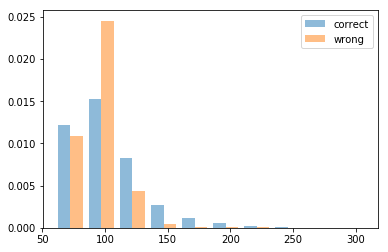

In [10]:
bins = [35,45,55,60,65,70]
plt.hist([correct_scroes,wrong_scores], 10, alpha=0.5, label=['correct','wrong'],density=True)
# plt.hist(wrong_scores, 10, alpha=0.5, label='wrong')
plt.legend(loc='upper right')
# plt.show()

In [11]:
# check unigrams intersection with other relations, both on tokens and entities
# on train as well
for d in result_per_type['NOTA'][0]:
    show_set(d)
    print()
    

head: apa   ,   tail soldz
NOTA no_relation	 `` This is a repudiation by the membership of a policy that has been doggedly pursued by apa leadership for year after year , '' soldz said Thursday . ; 

head: him   ,   tail she
per:spouse	 His wife , Barbara , often accompanied him on his expeditions , as she did in 1947 , when she became the first woman to climb Mount McKinley . 0.00; 65.92
head: citibank   ,   tail haiti
org:country_of_headquarters	 The president of haiti 's citibank was also among the survivors being treated there , said Rafael Sanchez Espanol , director of the Homs Hospital in Santiago .  0.00; 65.58
head: abc   ,   tail australian communications and media authority
org:member_of	 The australian communications and media authority is proposing to make changes to commercial and abc radio services in the Gympie area .  0.00; 98.76
head: he   ,   tail thursday
per:date_of_death	 Waldheim , whose reputation was tarnished by revelations that he had been a Nazi officer who s

head: council   ,   tail tung cheng-yuan
org:top_members/employees	 MAC Vice Chairman tung cheng-yuan made the remarks after members of the council met to pass revised regulations concerning residents from the two former Western colonies coming to Taiwan to study .  0.00; 76.04
NOTA  0.00; 76.78619384765625


head: jeremy hooper   ,   tail nh
NOTA no_relation	 jeremy hooper at Good As You responds to NOM 's anti-gay marriage nh ad . ; 

head: chávez   ,   tail chávez
per:alternate_names	 It 's tempting to laugh this off as mere foolishness , chávez being chávez , but no one should underestimate the lengths to which Venezuela 's leader is willing to go to promote his own self-interest . 0.00; 55.57
head: jewish national fund   ,   tail 1901
org:founded	 Tree-planting has an almost mystical quality here : For decades , Jews the world over have dropped coins into blue-and-white boxes of the jewish national fund , which has planted 240 million trees in the Carmel Forest and elsewhere acros

org:top_members/employees	 `` You can identify someone as being at risk '' for suicide or other violence , `` but if they 're not doing anything illegal , you can refer them to the college counseling center and so forth , but you ca n't force them '' into treatment , said gerald koocher , dean of the School of Health Studies at Simmons College and a past president of the american psychological association . 0.00; 36.99
head: he   ,   tail abu zubaydah
per:other_family	 The book says abu zubaydah was confined in a box `` so small he said he had to double up his limbs in the fetal position '' and was one of several prisoners to be `` slammed against the walls , '' according to the Red Cross report .  1.00; 79.66
head: usa network   ,   tail nbc universal
org:parents	 Kevin McAuliffe , the vice president for branded entertainment for nbc universal 's cable properties , which include Bravo and usa network , said that creativity always comes first , but that product placement has a strong i

NOTA  0.00; 85.11580657958984


head: citibank   ,   tail coca-cola
NOTA no_relation	 Among those are dozens of subsidiaries which compose literally a who 's who list of some of the largest and most powerful US corporations , including ( among others ) : Ford , General Motors , DaimlerChrysler , Bridgestone Firestone , Goodyear , Alcoa , Shell , Pfizer , Dupont , Cargill , coca-cola , Kraft , Novartis , Unilever , Heinz , Johnson & Johnson , citibank , Colgate Palmolive , DHL and Owens Illinois . ; 

head: he made his debut in melbourne this year at the season - opening australian grand prix , hamilton   ,   tail afro - carribean
per:city_of_birth	 Since he made his debut in melbourne this year at the season - opening australian grand prix , hamilton , the first man of afro - carribean descent to drive in Formula One , has caused a sensation . 0.00; 51.48
head: ayatollah ali khamenei   ,   tail iran
per:countries_of_residence	 iran said on Wednesday it has produced more than 17 kilogra

head: harry dent   ,   tail sc
per:stateorprovince_of_death	 Survivors include his wife of 56 years , Betty Francis Dent of Columbia , sc ; four children , harry dent Jr of Tampa , Fla , Dolly Montgomery of Chapin , sc , Ginny Brant of Seneca , sc and Jack Dent of Alpharetta , Ga ; and nine grandchildren .  0.00; 73.81
head: morgan   ,   tail august
per:date_of_death	 morgan , who died in august , was a black woman who worked in a plant that made World War II bombers .  0.00; 79.01
head: deblanc   ,   tail southwestern louisiana institute
per:schools_attended	 After the war , Col. deblanc received his undergraduate degree from southwestern louisiana institute in 1947 , two master 's degrees , in physics education in 1951 and mathematics education in 1963 , from Louisiana State University and a doctorate in education from McNeese State University in 1973 .  0.00; 80.98
head: cpc   ,   tail central committee
org:members	 The central committee of the Communist Party of China ( cpc ) on We

org:stateorprovince_of_headquarters	 `` This is very unsettling news for parents , particularly when coupled with the shortage of the vaccine , '' said Irwin Redlener , director of the national center for disaster preparedness at Columbia University in new york and a professor of clinical public health and pediatrics at the university 's Mailman School of Public Health . 0.00; 44.53
head: ahmad qattan   ,   tail saudi
per:origin	 On Monday , saudi permanent representative to the Arab League ( AL ) ahmad qattan said here that he would head his country 's delegation to the summit , ruling out the presence of saudi King Abdullah or Foreign Minister Prince Saud al-Faisal .  1.00; 93.80
head: juanita jackson mitchell   ,   tail parren mitchell
per:other_family	 parren mitchell 's sister-in-law , juanita jackson mitchell , was the long - time head and legal counsel of the Maryland NAACP .  0.00; 67.91
head: aba   ,   tail denver rockets
org:members	 While free agency technically had existed 

head: jennifer dunn   ,   tail inova alexandria
per:country_of_death	 jennifer dunn , a Washington state Republican who served in the U.S. House of Representatives for six terms and became one of her party 's most visible leaders in the 1990s , died Wednesday at suburban inova alexandria ( Va. ) Hospital of a pulmonary embolism . 0.00; 42.41
head: lashkar-e-taiba   ,   tail hafiz saeed
org:founded_by	 Jamaat-ud-Dawa is run by hafiz saeed , who founded lashkar-e-taiba in 1989 .  0.00; 65.21
head: danny glover   ,   tail ahab
per:alternate_names	 In a mythical land , ahab ( danny glover ) sets out to find the Great White Dragon , a fire-breathing monster that killed his sister and left him horribly scarred .  0.00; 45.37
head: kurnaz   ,   tail bremen
per:city_of_birth	 kurnaz , who was born in bremen , Germany , but has Turkish citizenship , was detained in Pakistan in 2001 , turned over to US authorities and held at the US prison camp at Guantanamo Bay as a terror suspect until his rel

head: bolin   ,   tail april 11 , 1908
per:date_of_birth	 bolin , born on april 11 , 1908 , in Poughkeepsie , New York , was the daughter of a successful lawyer .  0.00; 45.38
head: nec   ,   tail nec electronics corp
org:subsidiaries	 Japan 's nec says net profit fails to meet forecast Semiconductor subsidiary nec Electronics Corp posted a net loss of 18 billion yen , bigger than its initial estimate for a loss of 15 billion yen after taking charges on deferred tax assets of its US business .  1.00; 84.89
head: parren mitchell   ,   tail u.s.
per:country_of_death	 u.s. Rep. parren mitchell , founding member of Congressional Black Caucus , dies at 85  0.00; 35.51
head: option one mortgage   ,   tail irvine
org:city_of_headquarters	 irvine , Calif-based option one mortgage and Orange , Calif-based Ameriquest Mortgage Co are looking to be bought .  0.00; 65.90
NOTA  0.00; 76.0763931274414


head: bernama   ,   tail thai government
NOTA no_relation	 The Thai News Agency reported , quoting

head: his   ,   tail she
per:spouse	 his wife , Barbara , often accompanied him on his expeditions , as she did in 1947 , when she became the first woman to climb Mount McKinley .  0.00; 65.26
head: his   ,   tail leader
per:title	 A close follower of Khomeini before and after the fall of the shah in 1979 , Khamenei has never wavered from the strictly Islamic vision set out by his predecessor as supreme leader .  0.00; 52.35
NOTA  0.07; 82.15707397460938


head: his   ,   tail binoche
NOTA no_relation	 And binoche is his flip side -- proud yet worried , needy but strong . ; 

head: sac   ,   tail robert mcnamara
org:founded_by	 By the time the early problems had largely been resolved and sac interest in the bomber had solidified , Secretary of Defense robert mcnamara decided that the B-58 was not going to be a viable weapon system . 0.00; 52.59
head: paul sculfor   ,   tail victoria
per:spouse	 Earlier in the day , victoria spent some time around town shopping and stuff with an entoura

NOTA no_relation	 Another was a showing of `` The Social Network , '' the new film about Facebook , with a panel afterward that included Jesse Eisenberg and justin timberlake , who play Facebook founder Mark Zuckerberg and Napster co-founder sean parker . ; 

head: opera national de paris   ,   tail paris
org:city_of_headquarters	 Swiss conductor Philippe Jordan to join paris Opera Swiss conductor Philippe Jordan has been named the next music director at the opera national de paris , the French opera house said . 0.00; 58.99
head: tianjin lions   ,   tail cbl
org:member_of	 Rong Lan , a teacher in Tianjin , a city of more than 10 million people about 150 kilometers ( 90 miles ) southeast of Beijing and home to the cbl 's tianjin lions , said the Chinese just do n't get baseball .  0.00; 42.81
head: deaver   ,   tail bethesda
per:city_of_death	 deaver , who had pancreatic cancer , died at his home in bethesda , Maryland , according to a statement from the deaver family that was issued b

head: conagra   ,   tail last year
NOTA no_relation	 conagra 's Chief Executive Gary Rodkin told lawmakers his company has invested millions of dollars modernizing its food safety controls after two salmonella-related recalls last year . ; 

head: boxer   ,   tail barbara boxer
per:alternate_names	 But hyperventilating bloviators jumped all over Sen. barbara boxer last week for alluding to Secretary of State Condoleezza Rice 's single status -- as though boxer were accusing Rice of botching the Iraq war because she 's a spinster . 0.00; 31.57
head: forsberg   ,   tail new york
per:stateorprovince_of_birth	 forsberg was born in 1943 in Huntsville , Ala. , and grew up on Long Island in new york .  0.00; 42.06
head: john kerry   ,   tail yale university
per:schools_attended	 Police use stun gun on student as Senator john kerry looks on Meyer asked Kerry about impeaching US President George W Bush and whether he and Bush had been members of the secret `` Skulls and Bones '' society when th

NOTA  0.01; 71.39278411865234


head: his   ,   tail 2
NOTA no_relation	 But that slowed his progress , and he threw the 2 - by-4 away . ; 

head: david gregory   ,   tail nbc
per:employee_of	 nbc names david gregory host of ' Meet the Press ' `` I 've thought a lot about what it means to succeed somebody like Tim Russert , '' Gregory told viewers . 0.00; 35.96
head: safe passage   ,   tail 1999
org:founded	 In 1999 she founded the nonprofit safe passage program , set up a school in a small abandoned church at the dump , and ministered to the poor .  0.85; 73.53
head: first automobile works   ,   tail faw
org:alternate_names	 They were Shanghai Automotive Industry Corporation ( SAIC ) , first automobile works ( faw ) , Dongfeng Motors , Chang ` an Motors , Beijing Automobile Works , Guangzhou Automobile Industry Group , Chery Automobile , Jianghuai Automobile Group , Hafei Auto and Brilliance Automotive .  0.06; 70.87
head: he   ,   tail washington
per:stateorprovinces_of_residence	 he

head: harry dent   ,   tail sc
per:stateorprovince_of_death	 Survivors include his wife of 56 years , Betty Francis Dent of Columbia , sc ; four children , harry dent Jr of Tampa , Fla , Dolly Montgomery of Chapin , sc , Ginny Brant of Seneca , sc and Jack Dent of Alpharetta , Ga ; and nine grandchildren .  0.00; 41.39
head: beyonce   ,   tail craig david
per:other_family	 All Saints ' `` Studio 1 '' includes collaborations with Karl Gordon ( Liberty X , Javine ) , Rick Nowels ( craig david , Alicia Keys ) , Amanda Ghost ( beyonce , Janet Jackson ) and Greg Kurstin ( Natasha Bedingfield , Jessica Simpson ) .  0.00; 46.26
head: yoadimnadji   ,   tail paris
per:city_of_death	 yoadimnadji , 56 , died of cerebral haemorrhage in a paris hospital soon after being urgently airlifted from the Chadian capital of N'djamena to paris .  0.00; 31.90
head: national beef packing co.   ,   tail kansas city
org:city_of_headquarters	 The Department of Justice said it would n't challenge that deal , but 

per:country_of_birth	 Chris Bentley of the u.s. Citizenship and Immigration Services said the baby has American citizenship because she was born in u.s. airspace .  0.00; 57.47
head: his   ,   tail russia
per:country_of_death	 Kaiser 's parents had emigrated in 1905 from Ukraine , then part of russia , where his four oldest siblings were born .  0.00; 42.73
NOTA  0.15; 83.3844223022461


head: holly montag   ,   tail last thursday
NOTA no_relation	 Ms Pratt was pulled over at 3:45 am in Hollywood because of an equipment violation after leaving a party for holly montag ( Heidi 's sister ) whose birthday was last thursday ( October 15 ) . ; 

head: ahearn   ,   tail tennessee
per:stateorprovinces_of_residence	 Fascinated by etiquette and politics since her youth in tennessee , ahearn combined both interests to become an only-in - Washington authority on the diplomatic niceties required at official dinners and other state occasions . 0.00; 63.68
head: oic   ,   tail ekmeleddin ihsanoglu
o

head: cnb   ,   tail czech national bank
org:alternate_names	 The czech national bank ( cnb ) said it had left its lending rates unchanged Thursday despite analysts ' expectations of a cut due to low inflation and poor economic data .  0.00; 76.80
head: teddy kollek   ,   tail jerusalem
per:city_of_death	 jerusalem -- teddy kollek , the legendary jerusalem mayor who presided over the reunification of the city after the 1967 Mideast war and tried to balance the needs of its split Jewish and Arab populations , has died at the age of 95 .  0.00; 71.94
head: babyshambles   ,   tail 2005
per:date_of_birth	 Doherty formed his latest band , babyshambles , in 2005 , and shot to tabloid notoriety after starting a relationship with supermodel Kate Moss .  1.00; 89.86
head: rovers   ,   tail premier league
org:member_of	 Tevez 's treble , his first for City and first since he scored four goals against rovers for Manchester United in a League Cup tie 13 months ago , was the centrepiece of a victor

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 millender-mcdonald   ,   tail cancer
per:cause_of_death	 millender-mcdonald is the second member of Congress to die this year of cancer .  0.00; 72.24
head: richard perle   ,   tail jewish
per:religion	 The site 's homepage carried the headline , `` Meet just a few of your jewish Supremacist Warmongers , '' above photos of William Kristol , richard perle , Ari Fleischer , Ariel Sharon , Paul Wolfowitz , Elliot Abrams and Douglas Feith . ''  0.00; 48.26
head: chavez   ,   tail venezuela
per:country_of_birth	 chavez rebuked Israeli President Shimon Peres for his recent prediction that the people of venezuela and Iran will soon make their leaders disappear .  0.00; 71.15
NOTA  0.00; 75.89380645751953


head: she   ,   tail joe
NOTA no_relation	 Erin has been frustrated watching the show , because any time Olivia did well , she would tell both her and joe , but it 's never shown . ; 

head: nicholas burns   ,   tail u.s.
per:countries_of_residence	 But nicholas burns , the u.s. undersecre

head: chavez   ,   tail ignoring the rebels ' crimes
per:charges	 Colombia 's government accused chavez of ignoring the rebels ' crimes and chavez 's critics say he has taken the guerrilla 's side .  0.00; 64.80
NOTA  0.02; 82.08722686767578


head: hashim ahmad al-tai   ,   tail war
NOTA no_relation	 Also sentenced to death were Sultan hashim ahmad al-tai , the former defense minister who led the Iraqi delegation at the cease-fire talks that ended the 1991 Gulf war , and Hussein Rashid Mohammed , a former deputy director of operations for the Iraqi armed forces . ; 

head: oic   ,   tail iran
org:members	 The 56 oic members include iran , Sudan and Syria . 0.00; 45.09
head: susan boyle   ,   tail catholic
per:religion	 Lastly I am excited about susan boyle 's new song Wild Horses , which is awesome , though the press in the US citing her as the world most famous catholic , made me giggle , surely that would be the Pope ?  0.00; 44.19
head: scheider   ,   tail infection
per:cause_of_de

per:alternate_names	 Most of the excitement seems to be about what ABC programming chief steve mcpherson will have to say in re Silverman when mcpherson announces his network 's pickup of NBC 's `` Scrubs . '' 0.00; 68.29
head: flowers   ,   tail parkinson 's disease
per:cause_of_death	 flowers died from parkinson 's disease at his home in Dothan on Thursday , his son , Richmond flowers Jr. , said Friday .  0.00; 43.27
head: flowers   ,   tail bribery
per:charges	 flowers , who later served a prison term for bribery , was 88 .  0.00; 51.48
head: patterson energy   ,   tail 2001
org:founded	 The company was formed in 2001 by patterson energy 's acquisition of UTI Energy .  0.00; 84.45
head: lindsey hord   ,   tail florida fish and wildlife conservation commission
per:employee_of	 lindsey hord , 55 , has worked for the florida fish and wildlife conservation commission for nearly three decades .  0.99; 92.17
NOTA  0.01; 87.52639770507812


head: american bar association   ,   tail legal s

per:countries_of_residence	 By placing his personal seal of approval on the election 's official result , ayatollah ali khamenei significantly raised the stakes for iran 's political opposition , which must now either concede the election or be seen as challenging the supreme leader himself .  0.00; 51.12
NOTA  0.00; 82.24526977539062


head: he   ,   tail continental
NOTA no_relation	 But Goldwater did not win , and the view at the time was that since he was born in a continental territory that later became a state , he probably met the standard . ; 

head: her   ,   tail she
per:parents	 Gibson says she tests designs on her 4-year-old daughter , Savannah Faith , and assorted friends . '' 0.00; 61.32
head: she   ,   tail scottish
per:country_of_death	 There were doubts as to whether she would perform in the `` Britain 's Got Talent '' live show in the scottish city after she pulled out of an event in Manchester , northwestern England , on Sunday night .  1.00; 99.33
head: covidien   ,

head: lashkar-e-taiba   ,   tail sunni muslim
org:political/religious_affiliation	 The US State Department says that lashkar-e-taiba is the military wing of Markaz ud-Daoua Wal-Irshad ( MDI ) , a strongly anti-American group founded in 1989 , which follows the fundamentalist Wahhab strain of the sunni muslim faith .  0.00; 73.91
head: richard perle   ,   tail jewish
per:religion	 The site 's homepage carried the headline , `` Meet just a few of your jewish Supremacist Warmongers , '' above photos of William Kristol , richard perle , Ari Fleischer , Ariel Sharon , Paul Wolfowitz , Elliot Abrams and Douglas Feith . ''  0.00; 32.05
head: firstgroup   ,   tail laidlaw
org:subsidiaries	 `` firstgroup 's acquisition of laidlaw will considerably enhance firstgroup 's existing activities in North America , which themselves have grown strongly since we first invested in the U.S. in 1999 , '' said firstgroup Chief Executive Moir Lockhead .  1.00; 100.71
NOTA  0.00; 82.59183502197266


head: nsc 

head: madoff securities   ,   tail rosenkranz
NOTA no_relation	 `` Our due diligence , which got into both account statements of his customers , and the audited statements of madoff securities , which he filed with the SEC , made it seem highly likely that the account statements themselves were just pieces of paper that were generated in connection with some sort of fraudulent activity , '' rosenkranz said . ; 

head: zondervan   ,   tail harpercollins
org:parents	 zondervan is a division of harpercollins . 0.90; 95.11
head: she   ,   tail ryan
per:spouse	 Today , she and ryan live in Colorado with two children , Maxwell Alston and Blakesley Grace , and she 's putting all her relationship and TV experience to use for us here at Watch With Kristin by blogging weekly about the new season of The Bachelorette , featuring Jillian Harris .  0.00; 73.88
head: china national aviation   ,   tail october
org:dissolved	 The three airlines merged into china national aviation Holding Company ( CNAH

head: morgan   ,   tail resisting arrest
per:charges	 morgan was arrested and pleaded guilty the next October to resisting arrest , paying a $ 100 fine .  1.00; 97.63
head: beyonce   ,   tail tina knowles
per:parents	 beyonce 's mother , tina knowles , has filed for divorce from the pop diva 's father and manager , Mathew Knowles .  0.00; 58.91
head: nec corp   ,   tail nec electronics
org:subsidiaries	 nec electronics shot up 500 yen or 1577 percent to 3,670 after the Nikkei business daily reported that nec corp had received an offer from US investment fund Perry Capital LLC to buy 3087 million shares in the semiconductor subsidiary for 5,000 yen apiece .  0.00; 67.83
head: david banda   ,   tail malawi
per:country_of_birth	 Madonna begins second visit to malawi The pop star first came to malawi in October 2006 to start an adoption process of one-year-old david banda .  0.00; 80.56
NOTA  0.00; 74.53141021728516


head: cartier watches   ,   tail replia
NOTA no_relation	 Cartier-W20108

head: julia carson   ,   tail march 11
NOTA no_relation	 Political newcomer Andre Carson is the Democratic nominee in a march 11 special election to succeed his late grandmother , julia carson , representing Indiana 's 7th District . ; 

head: william anderson   ,   tail adidas
per:employee_of	 `` The way we view this is as safeguarding our reputation , '' said william anderson , head of social and environmental affairs in the Asia Pacific region for adidas . 0.00; 53.60
head: american bankers association   ,   tail republican
org:political/religious_affiliation	 And it is the Club for Growth , not the american bankers association , that in recent years has backed primary campaigns against those it perceives as republican apostates .  0.00; 45.90
head: pascal yoadimnadji   ,   tail friday
per:date_of_death	 Chadian Prime Minister pascal yoadimnadji died friday at a Paris hospital where he was being treated for cardiovascular problems , the African nation 's embassy said .  1.00; 118.40

per:country_of_death	 BEIRUT , Lebanon ( AP ) Sheik abbas musawi , Hezbollah 's secretary-general , his wife and son were killed in February 1992 when Israeli helicopters fired rockets at his car in southern lebanon .  0.00; 47.24
head: irene morgan kirkaldy   ,   tail hayes
per:city_of_death	 irene morgan kirkaldy , whose defiance of white supremacy while traveling through the Upper South in the summer of 1944 led to a Supreme Court decision outlawing segregated seating on interstate bus lines , died Friday in hayes , Va. .  0.00; 46.52
head: abu zubaydah   ,   tail conspiracy to carry out terror attacks
per:charges	 abu zubaydah , who was at large , was found guilty of conspiracy to carry out terror attacks in Jordan .  0.00; 56.53
head: lee   ,   tail united states
per:countries_of_residence	 However , the united states reportedly disagreed with lee 's views and dissuaded Taiwan from launching such a development project .  0.00; 51.70
NOTA  0.00; 76.71211242675781


head: jewish nat

head: mahdi   ,   tail a couple of years
NOTA no_relation	 I 've been crowing like Paul Revere about the hidden mahdi sub-faction for a couple of years now . ; 

head: harry dent   ,   tail elizabeth patch
per:spouse	 Born in Allentown , Pa. , the youngest of eight children of elizabeth patch and harry dent , she graduated in 1946 from Oberlin College with a degree in botany . 0.00; 37.53
head: deaver   ,   tail calif.
per:stateorprovince_of_birth	 Mr. deaver , who was born in Bakersfield , calif. , on April 11 , 1938 , and graduated from San Jose State College , is survived by his wife , Carolyn ; a daughter , Amanda deaver of Washington ; a son , Blair , of Bend , Ore. ; three grandchildren ; a sister , Susan Wiggins of Tehachapi , calif. ; and a brother , William , of Mojave , calif. .  0.00; 40.62
head: her   ,   tail catholic
per:religion	 Devout catholic Miss Boyle has been at the centre of a media storm since news emerged of how she wowed Britain 's Got Talent judges Simon Cowel

head: national museum of women in the arts   ,   tail nw
org:website	 `` Role Models : Feminine Identity in Contemporary American Photography '' is on display through Jan 25 at the national museum of women in the arts , 1250 New York Ave nw .  0.00; 73.18
head: sac   ,   tail robert mcnamara
org:founded_by	 By the time the early problems had largely been resolved and sac interest in the bomber had solidified , Secretary of Defense robert mcnamara decided that the B-58 was not going to be a viable weapon system .  0.58; 94.82
head: sculfor   ,   tail los angeles
per:cities_of_residence	 TELEVISIONISTANet Entertainment Exposed sculfor , who was discovered by the London-based Select modeling agency lives in los angeles and is under contract with New York Model Management .  0.00; 32.03
NOTA  0.42; 94.47937774658203


head: hashim ahmad al-tai   ,   tail iraqi high tribunal
NOTA no_relation	 In addition to al-Majid , the iraqi high tribunal upheld death sentences of former defense minister

NOTA no_relation	 Pomaranca ( yugoslavia ) - released an album called Peklenska Pomaranca in 1982 , meant to have sounded like a cross between the scorpions and Accept . ; 

head: nitschmann middle school   ,   tail bethlehem
org:city_of_headquarters	 John Acerra , 50 , apologized to students , teachers and parents at nitschmann middle school in bethlehem , Pennsylvania , where he was arrested in February after he tried to sell meth to an informant . 0.00; 53.96
head: mia farrow   ,   tail patrick farrow
per:spouse	 Last year , a nephew of mia farrow and patrick farrow who had spent nearly 20 years in the Army was killed in Iraq .  0.00; 29.88
head: taiwan research institute   ,   tail taiwan
org:country_of_headquarters	 The year 2008 is expected to be one of slow economic growth for almost all major economies and taiwan is no exception with an economic growth rate estimated at 4.23 percent , the head of the taiwan research institute ( TRI ) said Wednesday .  0.92; 86.16
head: he   ,  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 On Monday , the chief of Iran 's Atomic Energy Organization , Ali Akbar Salehi , told iranian state television that he and his colleagues were `` working out a timetable for the inspection '' of the just revealed nuclear site outside the city of Qum .  0.00; 65.13
head: vernon bellecourt   ,   tail wabun-inini
per:alternate_names	 vernon bellecourt -- whose Ojibwe name , wabun-inini , means `` Man of Dawn '' or `` Daybreak '' -- was born on the White Earth Indian Reservation in Minnesota .  0.01; 79.97
head: his   ,   tail amalia
per:spouse	 Smits stands at the center of this multigenerational saga as Alex Vega , the adopted son of rum and sugar baron Pancho Duque ( Elizondo ) and his wife , amalia ( Moreno ) .  0.99; 84.75
NOTA  0.00; 69.8946533203125


head: fotf   ,   tail 4
NOTA no_relation	 Bruce Hausknecht , judicial analyst for Focus on the Family Action ( fotf 's 501 ( c ) ( 4 ) ) , agreed . ; 

head: david banda   ,   tail madonna
per:parents	 david banda ( son of madonna and

head: he   ,   tail spain
NOTA no_relation	 he and his wife , Ann McGarry Buchwald , whom he had met in Paris , moved to Washington in 1963 with their three children , who were adopted from orphanages and child welfare agencies in Ireland , spain and France . ; 

head: barbara boxer   ,   tail california
per:stateorprovinces_of_residence	 barbara boxer and Dianne Feinstein of california have introduced legislation to raise the insurance liability limits set by the Oil Pollution Act of 1990 . 1.00; 96.31
head: she   ,   tail him
per:siblings	 As TMZ reported , Barron Hilton called big sis and pleaded with her to bail him out ... she said no .  0.00; 62.50
head: her   ,   tail cancer
per:cause_of_death	 Beverly Sills , the Brooklyn-born opera diva who was a global icon of can-do American culture with her dazzling voice , bubbly personality and management moxie in the arts world , died of cancer , her manager said .  0.00; 46.01
head: covidien   ,   tail last year
org:dissolved	 Shares of

head: chunghwa telecom   ,   tail taiwan
org:country_of_headquarters	 chunghwa telecom , taiwan 's largest telecommunications company , will invest NT$ 13 billion ( US$ 403.76 million ) this year to set up four major cloud computing centers in what the company hopes will be the largest data hub in Asia , chunghwa telecom 's chairman said Thursday .  0.00; 62.92
NOTA  0.19; 78.30314636230469


head: faw   ,   tail shanghai volkswagen
NOTA no_relation	 The top 10 sedan brands , with sales totaling 1.12 million units and a 33-percent market share , included Jetta ( FAW-Volkswagen ) , Santana ( shanghai volkswagen ) , Buick Excelle ( Shanghai General Motors ) , Camry ( Guangzhou Honda ) , QQ ( Anhui Chery ) , and Xiali ( faw Tianjin ) . ; 

head: carnival corporation   ,   tail ocean conservation & tourism alliance
org:member_of	 The Yachts of Seabourn is a brand of carnival corporation and plc ( NYSE/LSE : CCL and NYSE : CUK ) , and supports the ocean conservation & tourism alliance , ded

In [12]:
def show_statson_all_relation(correct = 0):
    pred_acc = []
    scores_result = []
    std_result = [] 
    for k,v in result_per_type.items():
        scores_category = np.array(list(map(lambda x: x['scores'][int(x['prediction'])],v[correct])))
        pred_acc.append(len(v[1])/(len(v[0])+len(v[1]))*100)
        scores_result.append(scores_category.mean())
        std_result.append(scores_category.std())
        print(f"{k}:\t {scores_category.mean():.2f} +- {scores_category.std():.2f} ; {len(v[1])/(len(v[0])+len(v[1]))*100:.2f}%")
    #     print( k ,scores_category.mean(), "+-",scores_category.std(), " Acc is:", len(v[1])/(len(v[0])+len(v[1])))
    pred_acc = np.array(pred_acc)
    scores_result = np.array(scores_result)
    std_result = np.array(std_result)
#     X = np.stack((pred_acc,scores_result),axis=0)
#     print(np.cov(X))
#     print(np.corrcoef(np.stack((pred_acc,scores_result),axis=0)))
    return pred_acc,scores_result,std_result

In [13]:
pred_acc,scores_result_correct,std_result_correct = show_statson_all_relation(1)

per:cities_of_residence:	 102.82 +- 10.49 ; 53.66%
NOTA:	 82.23 +- 6.15 ; 49.19%
org:founded:	 117.29 +- 16.62 ; 91.06%
per:age:	 136.14 +- 29.34 ; 96.19%
org:political/religious_affiliation:	 156.93 +- 41.91 ; 81.73%
org:country_of_headquarters:	 111.62 +- 17.29 ; 74.07%
per:date_of_death:	 139.19 +- 30.09 ; 89.86%
per:title:	 109.12 +- 17.48 ; 61.72%
org:top_members/employees:	 119.01 +- 15.93 ; 88.07%
org:member_of:	 103.16 +- 27.46 ; 19.64%
per:country_of_death:	 109.86 +- 26.54 ; 49.54%
org:subsidiaries:	 111.76 +- 19.41 ; 68.60%
per:cause_of_death:	 151.36 +- 33.15 ; 94.23%
org:members:	 96.88 +- 15.97 ; 39.13%
per:origin:	 111.96 +- 15.26 ; 69.53%
org:alternate_names:	 110.87 +- 17.22 ; 68.35%
per:spouse:	 100.76 +- 12.36 ; 57.14%
org:parents:	 99.53 +- 15.86 ; 51.67%
org:city_of_headquarters:	 101.78 +- 8.76 ; 62.93%
per:stateorprovince_of_death:	 112.61 +- 14.95 ; 72.32%
per:charges:	 138.52 +- 31.40 ; 95.59%
org:stateorprovince_of_headquarters:	 102.55 +- 25.27 ; 65.52%
per:o

In [14]:
from scipy.stats import pearsonr


In [15]:
pearsonr(pred_acc,scores_result_correct)


(0.6860431391716876, 5.316776304768374e-07)

In [16]:
pred_acc,scores_result_wrong,std_result_wrong = show_statson_all_relation(0)

per:cities_of_residence:	 94.48 +- 11.65 ; 53.66%
NOTA:	 94.73 +- 13.94 ; 49.19%
org:founded:	 102.41 +- 16.29 ; 91.06%
per:age:	 86.10 +- 1.01 ; 96.19%
org:political/religious_affiliation:	 113.18 +- 41.71 ; 81.73%
org:country_of_headquarters:	 93.76 +- 13.41 ; 74.07%
per:date_of_death:	 107.33 +- 25.54 ; 89.86%
per:title:	 89.62 +- 6.88 ; 61.72%
org:top_members/employees:	 107.02 +- 12.92 ; 88.07%
org:member_of:	 89.01 +- 21.15 ; 19.64%
per:country_of_death:	 95.85 +- 13.54 ; 49.54%
org:subsidiaries:	 99.15 +- 15.86 ; 68.60%
per:cause_of_death:	 104.66 +- 12.21 ; 94.23%
org:members:	 89.26 +- 14.79 ; 39.13%
per:origin:	 98.83 +- 16.56 ; 69.53%
org:alternate_names:	 95.87 +- 15.82 ; 68.35%
per:spouse:	 93.12 +- 12.51 ; 57.14%
org:parents:	 90.74 +- 10.40 ; 51.67%
org:city_of_headquarters:	 90.32 +- 10.41 ; 62.93%
per:stateorprovince_of_death:	 94.16 +- 14.96 ; 72.32%
per:charges:	 90.50 +- 10.64 ; 95.59%
org:stateorprovince_of_headquarters:	 87.17 +- 12.10 ; 65.52%
per:other_family:	 

In [17]:
pearsonr(pred_acc,scores_result_wrong)

(0.42022502664406935, 0.005592806951573725)

In [18]:
from sklearn.metrics import confusion_matrix
mapping_rel_to_index = {}
for i,r in enumerate(result_per_type.keys()):
    mapping_rel_to_index[r] = i

In [19]:
labels = [x for x in result_per_type.keys()]
cm = confusion_matrix(gold_list, pred_list, labels)
for l in cm:
    print(l, sum(l))
# lcm = [[np.log1p(10*(x/sum(row))) for x in row] for row in cm ]
cm[0] = [x/16 for x in cm[0]]
print()
for l in cm:
    print(l, sum(l))
lcm = [[np.log1p(1*(x)) for x in row] for row in cm ]



[66 21  0  2  1  0  1  0  0  0  2  0  0  0  0  0  0  0  0  2  0  0  0  1
  0  5  0  8  0  1  1  0  1  4  0  4  0  0  1  1  0  1] 123
[  28 2485  130   75   40   67   95   29  103   40   30  102   62   81
   26  101   67   73   52   27   68   48   68   79   66   17   50   25
   62  141  131   30    7   21   82   24  105   36  133   49   55   42] 5052
[  0   1 112   0   1   0   0   0   1   0   0   0   0   0   0   1   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   2   0   0   0   0   0
   1   0   4   0   0   0] 123
[  0   4   0 101   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0   0   0   0   0] 105
[ 0 13  0  0 85  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  5  0  0  0  0  0  0  0  0  0] 104
[ 0 13  1  0  0 80  0  0  0  1  0  1  0  3  1  0  0  1  0  0  0  0  0  0
  0  0  0  0  0  0  1  1  0  0  0  0  3  0  2  0  0  0] 108
[  0   3   0   0   0   0 124  

[Text(0, 0.5, 'per:citi'),
 Text(0, 1.5, 'NOTA'),
 Text(0, 2.5, 'org:foun'),
 Text(0, 3.5, 'per:age'),
 Text(0, 4.5, 'org:poli'),
 Text(0, 5.5, 'org:coun'),
 Text(0, 6.5, 'per:date'),
 Text(0, 7.5, 'per:titl'),
 Text(0, 8.5, 'org:top_'),
 Text(0, 9.5, 'org:memb'),
 Text(0, 10.5, 'per:coun'),
 Text(0, 11.5, 'org:subs'),
 Text(0, 12.5, 'per:caus'),
 Text(0, 13.5, 'org:memb'),
 Text(0, 14.5, 'per:orig'),
 Text(0, 15.5, 'org:alte'),
 Text(0, 16.5, 'per:spou'),
 Text(0, 17.5, 'org:pare'),
 Text(0, 18.5, 'org:city'),
 Text(0, 19.5, 'per:stat'),
 Text(0, 20.5, 'per:char'),
 Text(0, 21.5, 'org:stat'),
 Text(0, 22.5, 'per:othe'),
 Text(0, 23.5, 'per:date'),
 Text(0, 24.5, 'per:chil'),
 Text(0, 25.5, 'per:city'),
 Text(0, 26.5, 'per:pare'),
 Text(0, 27.5, 'per:city'),
 Text(0, 28.5, 'per:alte'),
 Text(0, 29.5, 'org:numb'),
 Text(0, 30.5, 'org:webs'),
 Text(0, 31.5, 'per:coun'),
 Text(0, 32.5, 'per:reli'),
 Text(0, 33.5, 'per:stat'),
 Text(0, 34.5, 'org:foun'),
 Text(0, 35.5, 'per:stat'),
 Text(0

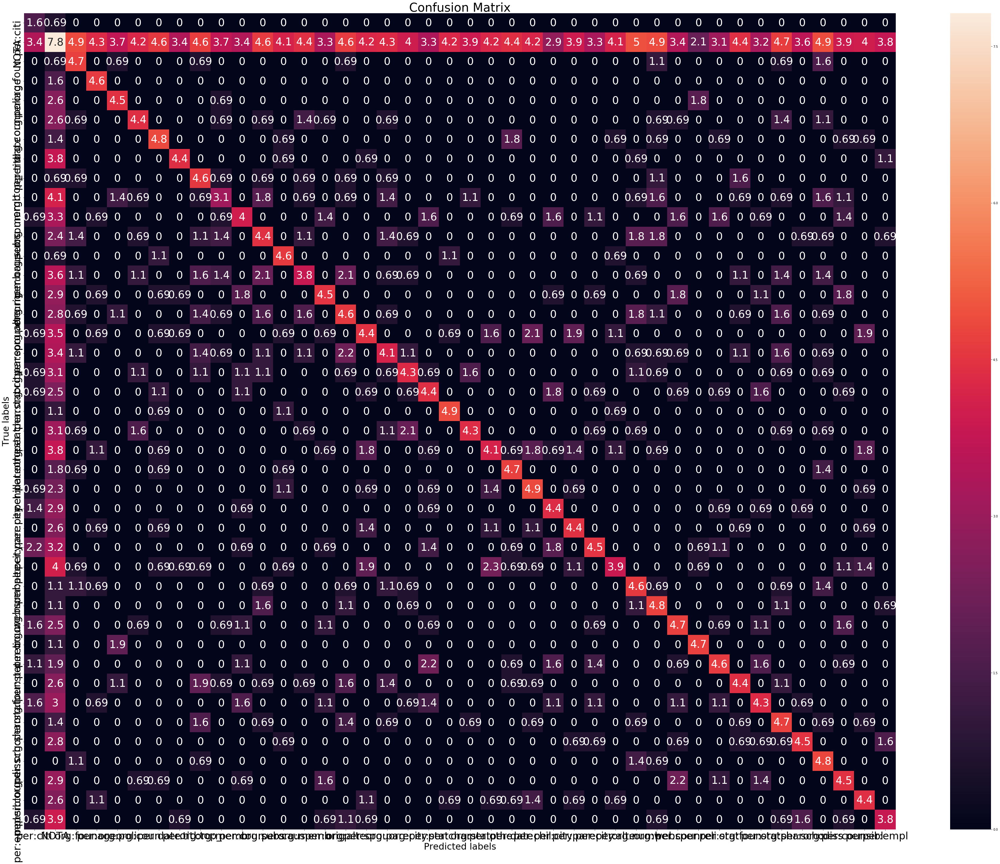

In [20]:
import seaborn as sns

fig = plt.figure(figsize=(65,50))
# ax = fig.add_subplot(111)
ax= plt.subplot()
sns.heatmap(lcm, annot=True, ax = ax,annot_kws={"size": 35}) #annot=True to annotate cells
# sns.set(font_scale=-4.4)
# labels, title and ticks

ax.set_xlabel('Predicted labels',fontsize=30);ax.set_ylabel('True labels',fontsize=30); 
ax.set_title('Confusion Matrix',fontsize=40); 
ax.xaxis.set_ticklabels([x[:8] for x in result_per_type.keys()],fontsize=34)
ax.yaxis.set_ticklabels([x[:8] for x in result_per_type.keys()],fontsize=34)



[Text(0, 0.5, 'per:citi'),
 Text(0, 1.5, 'NOTA'),
 Text(0, 2.5, 'org:foun'),
 Text(0, 3.5, 'per:age'),
 Text(0, 4.5, 'org:poli'),
 Text(0, 5.5, 'org:coun'),
 Text(0, 6.5, 'per:date'),
 Text(0, 7.5, 'per:titl'),
 Text(0, 8.5, 'org:top_'),
 Text(0, 9.5, 'org:memb'),
 Text(0, 10.5, 'per:coun'),
 Text(0, 11.5, 'org:subs'),
 Text(0, 12.5, 'per:caus'),
 Text(0, 13.5, 'org:memb'),
 Text(0, 14.5, 'per:orig'),
 Text(0, 15.5, 'org:alte'),
 Text(0, 16.5, 'per:spou'),
 Text(0, 17.5, 'org:pare'),
 Text(0, 18.5, 'org:city'),
 Text(0, 19.5, 'per:stat'),
 Text(0, 20.5, 'per:char'),
 Text(0, 21.5, 'org:stat'),
 Text(0, 22.5, 'per:othe'),
 Text(0, 23.5, 'per:date'),
 Text(0, 24.5, 'per:chil'),
 Text(0, 25.5, 'per:city'),
 Text(0, 26.5, 'per:pare'),
 Text(0, 27.5, 'per:city'),
 Text(0, 28.5, 'per:alte'),
 Text(0, 29.5, 'org:numb'),
 Text(0, 30.5, 'org:webs'),
 Text(0, 31.5, 'per:coun'),
 Text(0, 32.5, 'per:reli'),
 Text(0, 33.5, 'per:stat'),
 Text(0, 34.5, 'org:foun'),
 Text(0, 35.5, 'per:stat'),
 Text(0

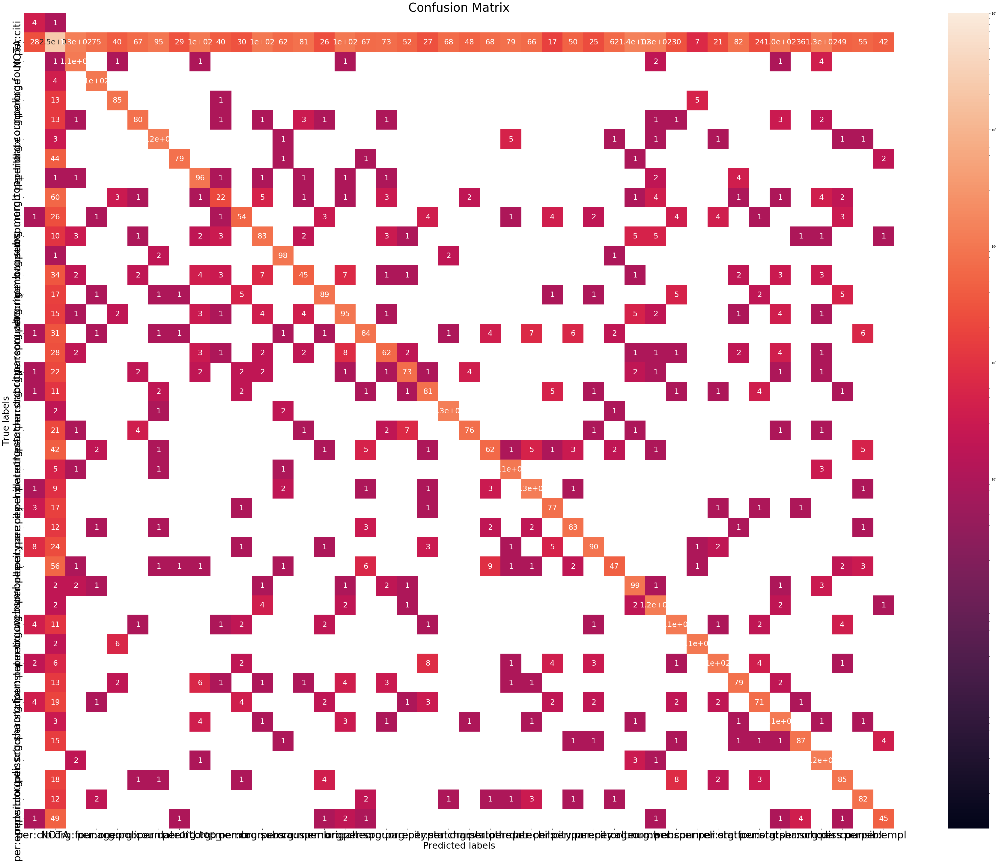

In [21]:
import seaborn as sns
from matplotlib.colors import LogNorm
log_norm = LogNorm(vmin=cm.min().min(), vmax=cm.max().max())

fig = plt.figure(figsize=(65,50))

ax= plt.subplot()

sns.heatmap(cm,norm=log_norm,cbar_kws={"ticks":[0,1,10,1e2,1e3,1e4,1e5]},
            vmin = 0.001, vmax=10000 ,annot=True, ax = ax,annot_kws={"size": 25}) #annot=True to annotate cells
# sns.set(font_scale=-4.4)
# labels, title and ticks

ax.set_xlabel('Predicted labels',fontsize=30);ax.set_ylabel('True labels',fontsize=30); 
ax.set_title('Confusion Matrix',fontsize=40); 
ax.xaxis.set_ticklabels([x[:8] for x in result_per_type.keys()],fontsize=34)
ax.yaxis.set_ticklabels([x[:8] for x in result_per_type.keys()],fontsize=34)



In [22]:
this_dict = {}
for k,v in wrong_prediction_which_rel.items():
    this_dict[k] = [rel_type for rel_type,count in v.most_common()[:5]]
this_dict

{'NOTA': ['org:number_of_employees/members',
  'org:dissolved',
  'org:website',
  'org:founded',
  'org:shareholders'],
 'org:political/religious_affiliation': ['NOTA',
  'per:religion',
  'org:member_of'],
 'org:member_of': ['NOTA',
  'org:subsidiaries',
  'org:dissolved',
  'org:website',
  'org:parents'],
 'org:members': ['NOTA',
  'org:subsidiaries',
  'org:alternate_names',
  'org:top_members/employees',
  'org:dissolved'],
 'org:subsidiaries': ['NOTA',
  'org:number_of_employees/members',
  'org:website',
  'org:founded',
  'org:parents'],
 'per:origin': ['NOTA',
  'per:country_of_birth',
  'per:countries_of_residence',
  'per:country_of_death',
  'per:stateorprovinces_of_residence'],
 'per:spouse': ['NOTA',
  'per:children',
  'per:siblings',
  'per:parents',
  'per:other_family'],
 'org:parents': ['NOTA',
  'org:alternate_names',
  'org:shareholders',
  'org:top_members/employees',
  'org:subsidiaries'],
 'per:date_of_death': ['per:date_of_birth',
  'NOTA',
  'per:alternate_na

In [23]:
# check agremment with the model prediction 
# try to come up with b=new baselines to show that data is no good
# Elmo should do worse?
# only entity type is helpful?


In [ ]:
E try to mimic with the same model
no realtion inside TACRED and it may be the target 

In [24]:
from sklearn.metrics import classification_report

In [25]:
labels = [x for x in result_per_type.keys()]
cr = classification_report(gold_list, pred_list, labels)
print(cr)

                                     precision    recall  f1-score   support

            per:cities_of_residence       0.55      0.54      0.54       123
                               NOTA       0.78      0.49      0.60      5052
                        org:founded       0.43      0.91      0.59       123
                            per:age       0.54      0.96      0.69       105
org:political/religious_affiliation       0.61      0.82      0.70       104
        org:country_of_headquarters       0.50      0.74      0.60       108
                  per:date_of_death       0.53      0.90      0.67       138
                          per:title       0.71      0.62      0.66       128
          org:top_members/employees       0.42      0.88      0.57       109
                      org:member_of       0.29      0.20      0.23       112
               per:country_of_death       0.51      0.50      0.50       109
                   org:subsidiaries       0.39      0.69      0.50       12

In [ ]:
#if SOTA on NOTA doesnt 
# look how can DA be done
# relation extraction in PubMed
# as they did in their paper use semeval as dev set in DA
# what was the dev accuracy in their paper
# ask them about resukt on the dev set

